In [1]:
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
import matplotlib.patches as patches
import matplotlib.gridspec as gridspec
import time
from tensorflow.python.layers.base import Layer

/opt/conda/lib/python3.6/importlib/_bootstrap.py:219: RuntimeWarning: compiletime version 3.5 of module 'tensorflow.python.framework.fast_tensor_util' does not match runtime version 3.6
  return f(*args, **kwds)
/opt/conda/lib/python3.6/site-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters


In [2]:
def make_toy_dataset_old(num_samples,noise):
    cir_sample=num_samples*2//3
    circle_circ_x = np.cos(np.linspace(0, np.pi, cir_sample))
    circle_circ_y = np.sin(np.linspace(0, np.pi, cir_sample))
    norm_sample=num_samples-cir_sample
    norm_circ_x = np.zeros(norm_sample)
    norm_circ_y = np.zeros(norm_sample)
    X=np.vstack((np.append(circle_circ_x,norm_circ_x),np.append(circle_circ_y,norm_circ_y))).T
    X += np.random.randn(X.shape[0],X.shape[1])*noise
    index=np.arange(num_samples)
    np.random.shuffle(index)
    return X[index,:]

def make_toy_dataset(num_samples,noise):
    circle_circ_x = np.cos(np.linspace(0, np.pi, num_samples))
    circle_circ_y = np.sin(np.linspace(0, np.pi, num_samples))
    X=np.vstack((circle_circ_x,circle_circ_y)).T
    X += np.random.randn(X.shape[0],X.shape[1])*noise
    index=np.arange(num_samples)
    np.random.shuffle(index)
    return X[index,:]

def make_toy_dataset_rect(num_samples,noise):
    edges=[num_samples//4,num_samples//4,num_samples//4,num_samples-(num_samples//4)*3]
    c0=(np.random.rand(edges[0])-0.5)/0.5
    c1=(np.random.rand(edges[1])-0.5)/0.5
    c2=(np.random.rand(edges[2])-0.5)/0.5
    c3=(np.random.rand(edges[3])-0.5)/0.5
    X=np.vstack((np.append(-1*np.ones(edges[0]),[np.ones(edges[1]),c2,c3]),np.append(c0,[c1,-1*np.ones(edges[2]),np.ones(edges[3])]))).T
    X += np.random.randn(X.shape[0],X.shape[1])*noise
    index=np.arange(num_samples)
    np.random.shuffle(index)
    return X[index,:]

def make_toy_dataset_bracket(num_samples,noise):
    edges=[num_samples//4,num_samples//4,num_samples//8,num_samples//8,num_samples//8,num_samples-(num_samples//4)*2-(num_samples//8)*3]
    c0=(np.random.rand(edges[0])-0.5)/0.5
    c1=(np.random.rand(edges[1])-0.5)/0.5
    c2=np.random.rand(edges[2])*0.5-1
    c3=np.random.rand(edges[3])*0.5-1
    c4=np.random.rand(edges[4])*0.5+0.5
    c5=np.random.rand(edges[5])*0.5+0.5
    x=np.concatenate([-1*np.ones(edges[0]),np.ones(edges[1]),c2,c3,c4,c5])
    y=np.concatenate([c0,c1,-1*np.ones(edges[2]),np.ones(edges[3]),-1*np.ones(edges[4]),np.ones(edges[5])])
    X=np.vstack((x,y)).T
    X += np.random.randn(X.shape[0],X.shape[1])*noise
    index=np.arange(num_samples)
    np.random.shuffle(index)
    return X[index,:]

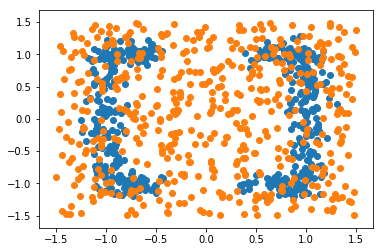

In [3]:
X_true=make_toy_dataset_bracket(500,0.1)
X_fake=np.random.uniform(low=-1.5,high=1.5,size=(500,2))
plt.scatter(X_true[:,0],X_true[:,1])
plt.scatter(X_fake[:,0],X_fake[:,1])
plt.show()

In [4]:
'''
**************************************************************************************************************
Problem: this model try to predict everything sample as positive to minimize loss
potential solution: saparate into two step: first freeze VAE, optimize classifier. Then optimize VAE
plan B: train a global classifier to classify true sample and uniform random noise(cover all true sample),
then freeze classifier, increase score of VAE output
**************************************************************************************************************
'''

tf.reset_default_graph()
X=tf.placeholder(dtype=tf.float32,shape=[None,2])
y=tf.placeholder(dtype=tf.int32,shape=[None])

mask_psed_neg=tf.reshape(tf.cast(tf.equal(y,1),tf.float32),(-1,1))
mask_not_psed_neg=tf.reshape(tf.cast(tf.logical_not(tf.equal(y,1)),tf.float32),(-1,1))

y_onehot=tf.one_hot(y,3)
eps=1e-10
Gaussian_scale=5.0

class Classifier(Layer):
    def __init__(self):
        self.linear1=tf.layers.Dense(units=256,name='linear1',activation=tf.nn.relu,_reuse=tf.AUTO_REUSE)
        self.linear2=tf.layers.Dense(units=256,name='linear2',activation=tf.nn.relu,_reuse=tf.AUTO_REUSE)
        self.linear3=tf.layers.Dense(units=256,name='linear3',activation=tf.nn.relu,_reuse=tf.AUTO_REUSE)
        self.linear4=tf.layers.Dense(units=3,name='linear4',_reuse=tf.AUTO_REUSE)
    
    def __call__(self,inputs):
        score=self.linear4(self.linear3(self.linear2(self.linear1(inputs))))
        return score
    
class VAE(Layer):
    def __init__(self):
        self.lstm_hidden_dim=20
        self.latent_dim=10
        self.n_time=4
        self.encoder_lstm=tf.contrib.rnn.LSTMCell(self.lstm_hidden_dim)
        self.decoder_lstm=tf.contrib.rnn.LSTMCell(self.lstm_hidden_dim)
        self.encode_mean=tf.layers.Dense(units=self.latent_dim,name='encode_mean')   # calculate mean of z
        self.encode_std=tf.layers.Dense(units=self.latent_dim,name='encode_std')   # calculate std of z
        self.unit_gaussian=tf.distributions.Normal(loc=tf.zeros(self.latent_dim),scale=Gaussian_scale*tf.ones(self.latent_dim))
        self.emit_net=tf.layers.Dense(units=2,name='emit_net')
        
    def __call__(self,inputs):
        batch_size=tf.shape(inputs)[0]
        state_encode=self.encoder_lstm.zero_state(batch_size, tf.float32)   # lstm tuple (c,h)
        state_decode=self.decoder_lstm.zero_state(batch_size, tf.float32)   # lstm tuple (c,h)
        original_image=tf.layers.flatten(inputs)
        output_image=None
        latent_loss_his=[]
        classifier_loss_his=[]
        likelihood_his=[]
        predict_his=[]
        image_his=[]
        
        for t in range(self.n_time):
            if t==0:
                image=original_image
            else:
                # use output_image for fake images, use original image for real image
                image=mask_psed_neg*output_image+mask_not_psed_neg*original_image
            image_his.append(image)
            '''
            Part I: Classifier
            **************************************************************************************************************
            There is a problem with classifier. 
            During classifing, we only want to train the variables in the classifiers.  (solved)
            During likelihood estimation, we do not want to change the variables in the classifiers. (unsolved)
            **************************************************************************************************************
            '''
            classifier_scope="CNN_classifier_"+str(t)
            input_image=tf.reshape(image,(-1,2))
            with tf.variable_scope(classifier_scope) as vs:
                classifier=Classifier()
                score_likelihood=classifier(input_image)
            with tf.variable_scope(classifier_scope) as vs:
                classifier=Classifier()
                score_classifier=classifier(tf.stop_gradient(input_image))
            
            score_likelihood_new=tf.reshape(score_likelihood[:,0]-score_likelihood[:,1],(-1,1))*mask_psed_neg
            likelihood_his.append(score_likelihood_new) # only record score for fake images
            classifier_loss_his.append(tf.losses.softmax_cross_entropy(logits=score_classifier,onehot_labels=y_onehot))
            predict_his.append(score_classifier)
            
            '''
            Part II: Recurrent VAE
            '''
            with tf.variable_scope("LSTM_encoder") as vs:
                encode_out,state_encode=self.encoder_lstm(image,state_encode)
            z_mean=self.encode_mean(encode_out)
            z_std=5.0*tf.exp(self.encode_std(encode_out))
            distrib_encode=tf.distributions.Normal(loc=z_mean,scale=z_std)
            Z=distrib_encode.sample()
            
            latent_loss=tf.reduce_sum(mask_psed_neg*tf.distributions.kl_divergence(distrib_encode,self.unit_gaussian),axis=1)
            latent_loss_his.append(latent_loss)
            
            with tf.variable_scope("LSTM_decoder") as vs:
                decode_out,state_decode=self.decoder_lstm(Z,state_decode)
                
            output_image=self.emit_net(decode_out)
            
        tot_latent_loss=tf.reduce_mean(latent_loss_his)
        tot_classifier_loss=tf.reduce_mean(classifier_loss_his)
        tot_likelihood_loss=tf.reduce_sum(likelihood_his,axis=0)  # accumulate score through time
#         tot_likelihood_loss=tf.reduce_mean(-tf.nn.sigmoid(tot_likelihood_loss))
        tot_likelihood_loss=tf.reduce_mean(-tot_likelihood_loss)
        
        tot_loss=tot_latent_loss+tot_classifier_loss+tot_likelihood_loss
            
        return image_his,tot_loss,tot_latent_loss,tot_classifier_loss,tot_likelihood_loss,predict_his


vae=VAE()
image_his,tot_loss,tot_latent_loss,tot_classifier_loss,tot_likelihood_loss,predict_his=vae(X)
tot_classifier_loss=tot_classifier_loss
tot_loss2=tot_latent_loss+tot_likelihood_loss

classifier_variables=[]
vae_variables=[]
for v in tf.global_variables():
    if v.name.find('CNN_classifier')!=-1:
        classifier_variables.append(v)
    else:
        vae_variables.append(v)

optimizier=tf.train.AdamOptimizer(learning_rate=1e-2)
train_step1 = optimizier.minimize(tot_classifier_loss,var_list=classifier_variables)
train_step2 = optimizier.minimize(tot_loss2,var_list=vae_variables)

In [5]:
vv0=[v for v in tf.global_variables() if v.name=='CNN_classifier_0/linear1/kernel:0'][0]
vv1=[v for v in tf.global_variables() if v.name=='CNN_classifier_1/linear1/kernel:0'][0]
vv2=[v for v in tf.global_variables() if v.name=='CNN_classifier_2/linear1/kernel:0'][0]
vv3=[v for v in tf.global_variables() if v.name=='CNN_classifier_3/linear1/kernel:0'][0]

new_score=[]

for t in range(4):
    with tf.variable_scope("CNN_classifier_"+str(t)) as vs:
        classifier=Classifier()
        n_score=classifier(X)
        new_score.append(n_score)

In [6]:
with tf.Session() as sess:
    tf.global_variables_initializer().run()
    X_true=make_toy_dataset_bracket(200,0.1)
    X_true=(X_true-np.array([0,0.5]))/np.array([0.5,0.5])
    X_fake=np.random.uniform(low=-3,high=3,size=(200,2))
    X_noise=np.random.uniform(low=-3,high=3,size=(200,2))
    image=np.vstack((X_true,X_fake,X_noise))
    label=np.concatenate((np.zeros(200),np.ones(200),2*np.ones(200)))
    a=sess.run(predict_his,feed_dict={X:image,y:label})
    b=sess.run(new_score,feed_dict={X:image,y:label})

In [7]:
# for v in tf.global_variables():
#     print(v)

In [8]:
# vv=[v for v in tf.global_variables() if v.name=='CNN_classifier_0/linear1/kernel:0'][0]
# vv2=[v for v in tf.global_variables() if v.name=='CNN_classifier_1/linear1/kernel:0'][0]
# vv3=[v for v in tf.global_variables() if v.name=='encode_mean/kernel:0'][0]
# a=tf.gradients(tot_loss,vv)[0]
# b=tf.gradients(tot_latent_loss,vv)[0]
# c=tf.gradients(tot_classifier_loss,vv)[0]
# d=tf.gradients(tot_likelihood_loss,vv)[0]
# print(a)
# print(b)
# print(c)
# print(d)

# with tf.Session() as sess:
#     tf.global_variables_initializer().run()
#     original0=sess.run(vv)
#     original1=sess.run(vv2)
#     X_true=make_toy_dataset(200,0.1)
#     X_fake=np.random.uniform(low=-1.5,high=1.5,size=(200,2))
#     image=np.vstack((X_true,X_fake))
#     label=np.concatenate((np.ones(200),np.zeros(200)))
#     ga=sess.run(a,feed_dict={X:image,y:label})
#     gc=sess.run(c,feed_dict={X:image,y:label})
#     gd=sess.run(d,feed_dict={X:image,y:label})
#     _=sess.run(train_step,feed_dict={X:image,y:label})
#     latter0=sess.run(vv)
#     latter1=sess.run(vv2)
# #     print(original0-latter0)
# #     print(original1-latter1)

In [9]:
# out1=tf.layers.dense(X,units=20,activation=tf.nn.relu)
# score=tf.layers.dense(out1,units=1)
# prob=tf.nn.sigmoid(score)
# predict=tf.cast(prob>0.5,tf.int32)

# with tf.Session() as sess:
#     tf.global_variables_initializer().run()
#     X_true=make_toy_dataset(200,0.1)
#     X_fake=np.random.uniform(low=-1.5,high=1.5,size=(200,2))
#     image=np.vstack((X_true,X_fake))
#     label=np.concatenate((np.ones(200),np.zeros(200)))
#     p=sess.run(predict,feed_dict={X:image,y:label})
#     print(p.reshape(-1,))
    

In [10]:
def display(i_his,image_id): 
    plt.figure(1)
    h=0.1
    xx, yy = np.meshgrid(
        np.arange(-1.5, 1.5, h),
        np.arange(-1.5, 1.5, h))
    points=np.c_[xx.ravel(), yy.ravel()]
    p_his=sess.run(new_score,feed_dict={X:points,y:np.zeros(points.shape[0])})
    for t in range(4):
        plt.subplot(2,2,t+1)
        Z=np.argmax(p_his[t],axis=1)
        Z=Z.reshape(xx.shape)
#         print('t =',t,Z)
        _=plt.contourf(xx,yy,Z,cmap=plt.cm.coolwarm_r, alpha=0.8)
        plt.scatter(i_his[t][:200,0],i_his[t][:200,1])
        plt.scatter(i_his[t][200:400,0],i_his[t][200:400,1])
#         plt.scatter(i_his[t][400:,0],i_his[t][400:,1])
        plt.axis('off')
        plt.colorbar(_)
    if image_id==0 or (image_id+1)%50==0:
        plt.savefig('figures/toy/bracket_dataset/toy_dataset_%03d.png' % (image_id+1))
    plt.show()

iteration  0
1.0859308 0.008687137 1.0991888 -0.021945087


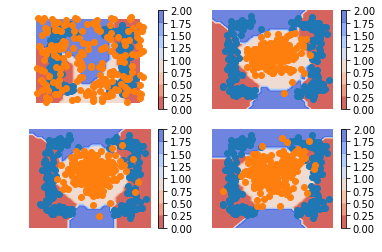

iteration  1
2.295966 0.008655156 0.8460516 1.4412591


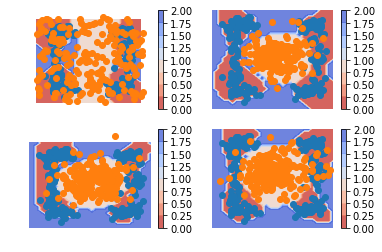

iteration  2
3.9273968 0.009210038 0.76623076 3.151956


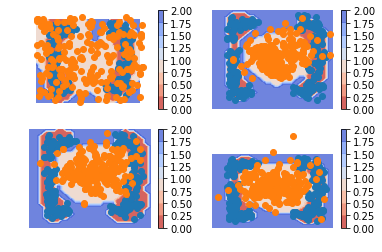

iteration  3
5.9688196 0.011670809 0.7497616 5.207387


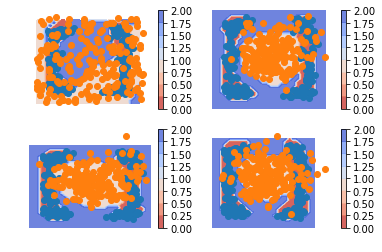

iteration  4
6.226722 0.016077396 0.7249298 5.4857144


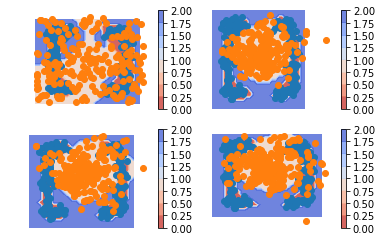

iteration  5
6.0434084 0.023857452 0.7799439 5.239607


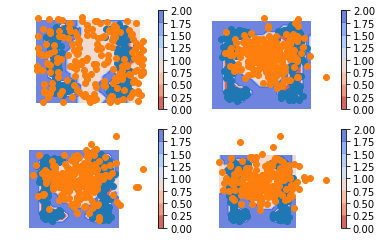

iteration  6
5.478477 0.03794931 0.8168867 4.623641


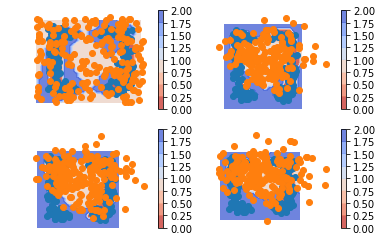

iteration  7
5.2926207 0.053153023 0.80460113 4.4348664


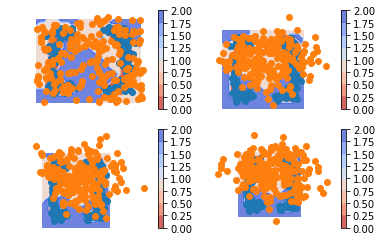

iteration  8
6.044595 0.066406235 0.8115879 5.1666007


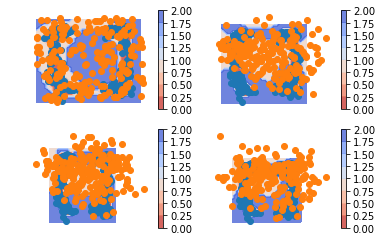

iteration  9
6.0489783 0.07120005 0.8011106 5.1766677


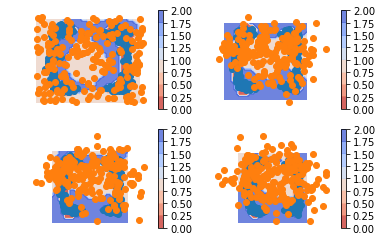

iteration  10
6.278959 0.06663734 0.8147799 5.3975415


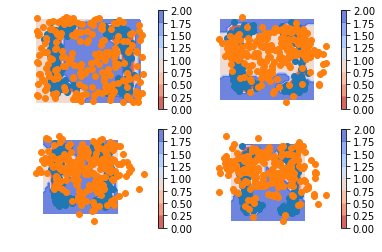

iteration  11
5.3608236 0.06537977 0.847677 4.447767


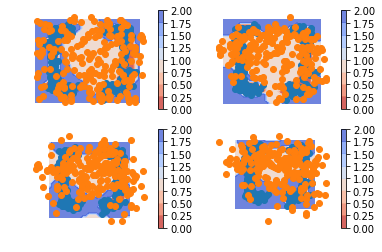

iteration  12
5.324037 0.067948766 0.81661123 4.439477


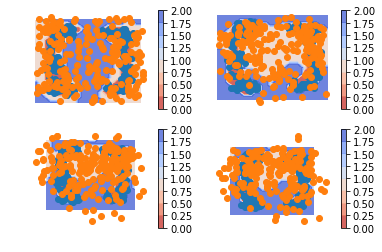

iteration  13
5.04322 0.07243867 0.8446412 4.12614


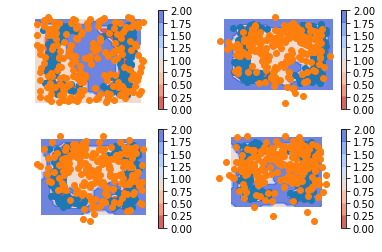

iteration  14
4.5948615 0.07187538 0.79565895 3.727327


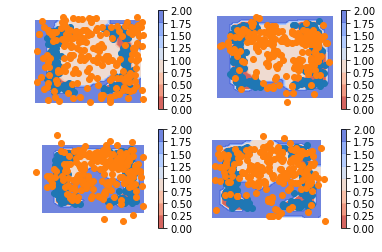

iteration  15
5.734362 0.074441366 0.8170198 4.8429008


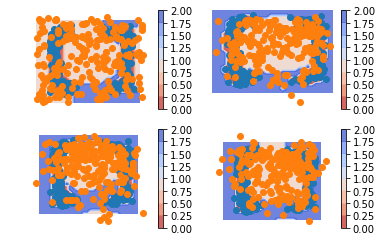

iteration  16
5.435783 0.07761775 0.8186571 4.539508


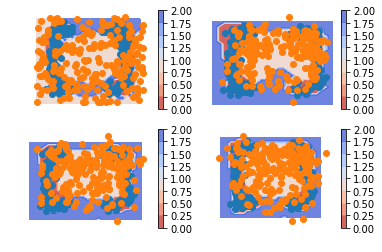

iteration  17
4.810322 0.07816297 0.8217218 3.910437


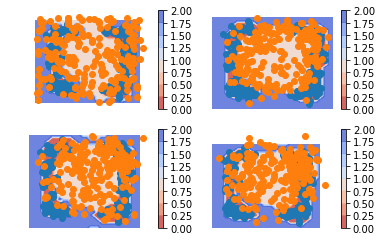

iteration  18
4.904904 0.079960234 0.8343927 3.990551


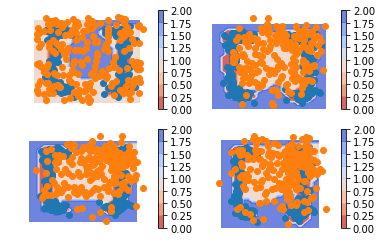

iteration  19
4.988143 0.08073358 0.8032448 4.1041646


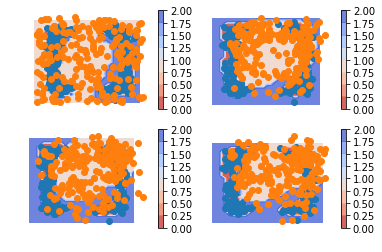

iteration  20
5.4585695 0.07935491 0.8515138 4.527701


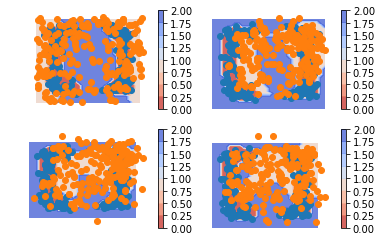

iteration  21
3.9745102 0.07736594 0.8364511 3.0606933


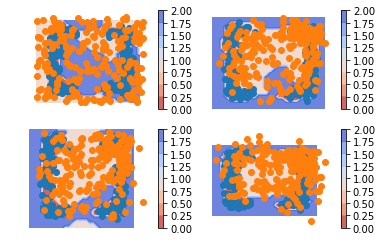

iteration  22
4.186253 0.076156214 0.81631964 3.2937772


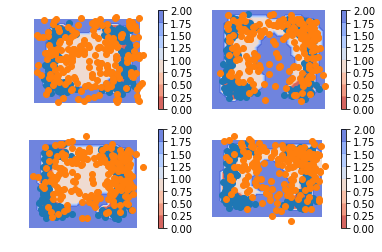

iteration  23
4.0451627 0.08074059 0.8110795 3.1533427


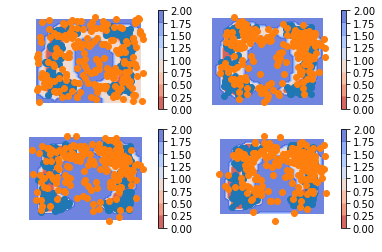

iteration  24
3.760356 0.08607273 0.84307116 2.831212


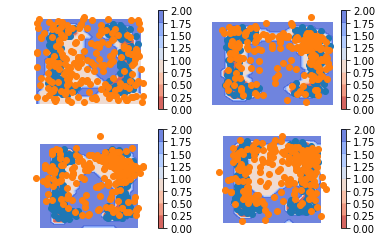

iteration  25
3.574355 0.09087851 0.83201283 2.6514635


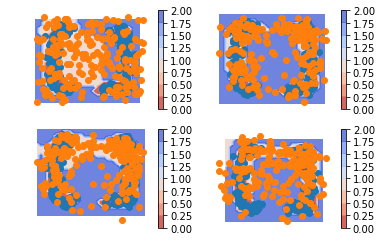

iteration  26
4.217896 0.092696585 0.8530088 3.2721906


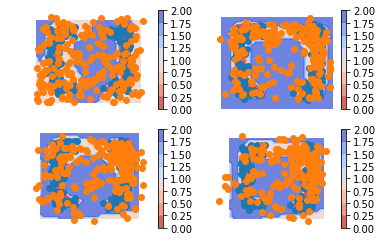

iteration  27
3.9799647 0.089592546 0.86304855 3.0273237


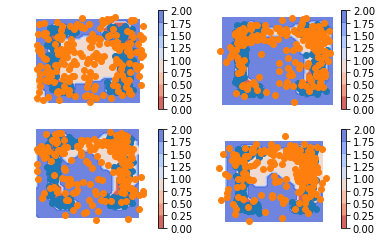

iteration  28
3.6975038 0.08737535 0.87725806 2.7328703


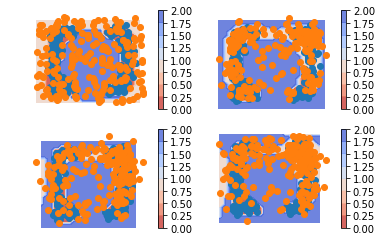

iteration  29
3.4343743 0.08175017 0.8497423 2.502882


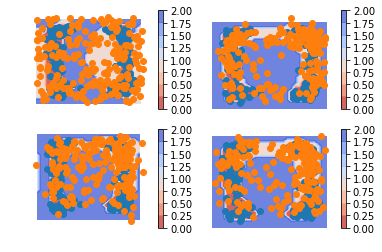

iteration  30
3.4315226 0.08139378 0.82001376 2.5301151


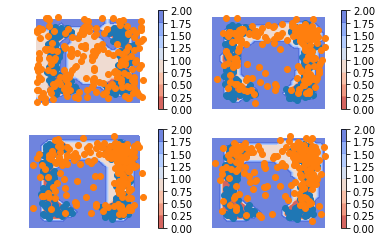

iteration  31
3.8501496 0.08217055 0.8581454 2.9098337


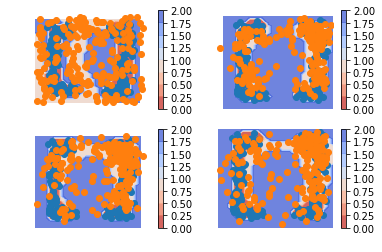

iteration  32
3.589739 0.08387034 0.830127 2.6757417


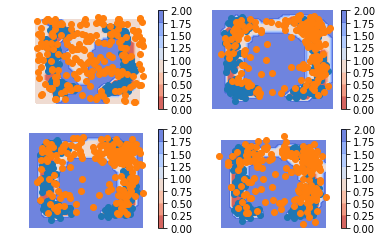

iteration  33
3.992701 0.08539912 0.88455003 3.0227518


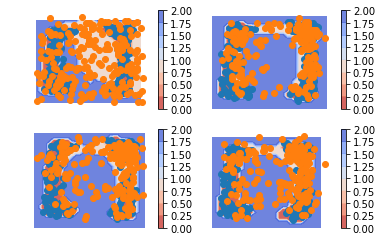

iteration  34
2.9151545 0.08831142 0.8340442 1.9927987


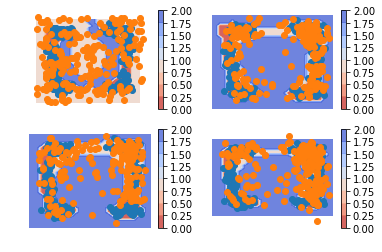

iteration  35
3.854432 0.09353132 0.8332897 2.927611


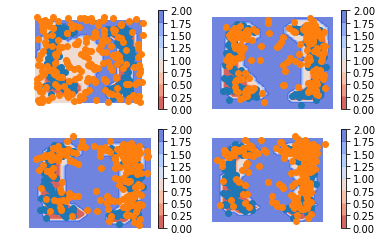

iteration  36
2.8644438 0.09506965 0.82614684 1.9432272


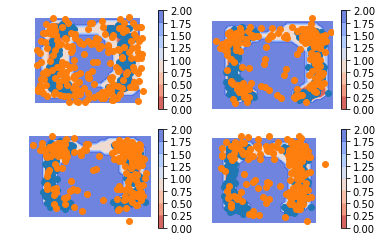

iteration  37
3.8469179 0.09552426 0.853289 2.8981047


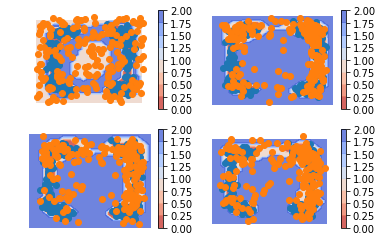

iteration  38
3.4131427 0.095403634 0.91136324 2.406376


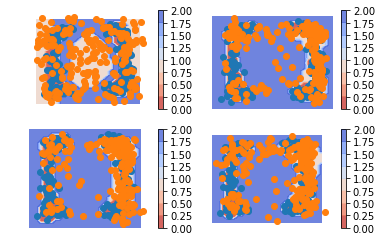

iteration  39
2.7156625 0.08880734 0.85149676 1.7753584


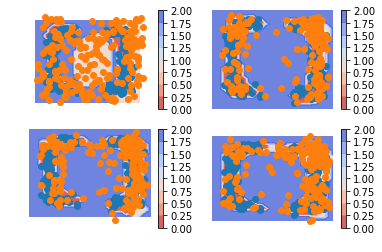

iteration  40
2.431706 0.0831507 0.8919051 1.4566501


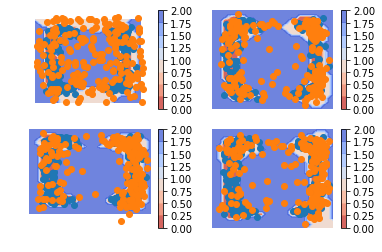

iteration  41
2.744285 0.073983215 0.85822636 1.8120756


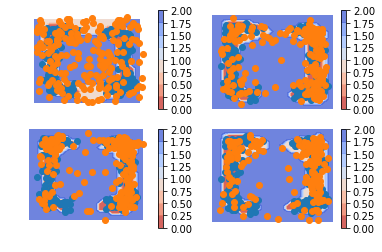

iteration  42
2.6486328 0.068523765 0.84451365 1.7355953


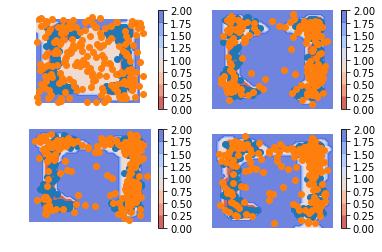

iteration  43
2.8090992 0.06195332 0.8257341 1.9214118


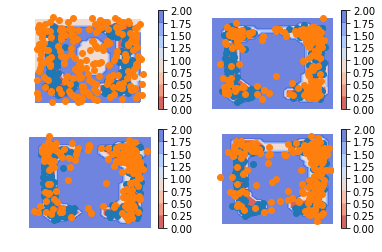

iteration  44
2.5106802 0.060442053 0.8557347 1.5945035


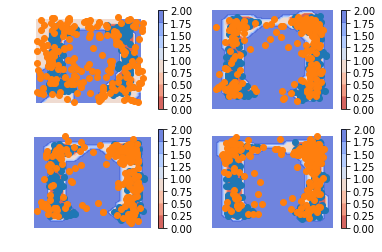

iteration  45
2.9378314 0.058514412 0.8187665 2.0605505


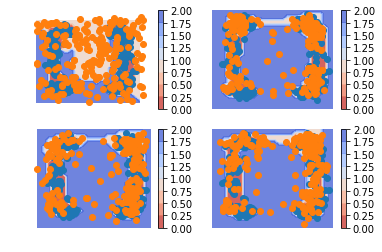

iteration  46
2.6783392 0.059858512 0.84171927 1.7767615


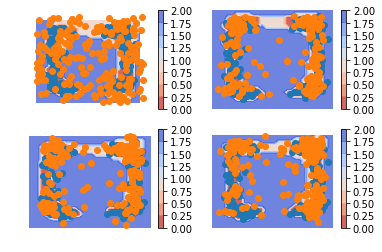

iteration  47
2.5171418 0.061937757 0.84104514 1.614159


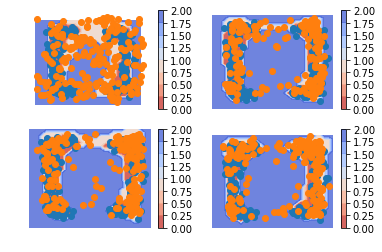

iteration  48
2.5708725 0.0641064 0.87019134 1.6365747


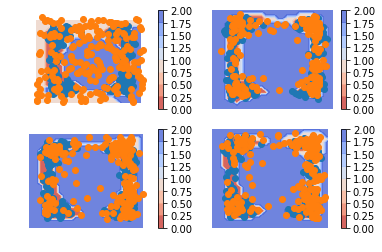

iteration  49
2.074131 0.06791581 0.8339128 1.1723025


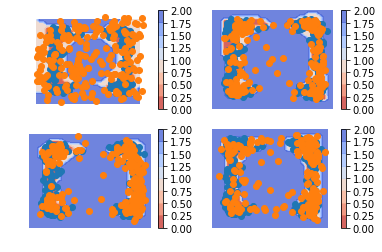

iteration  50
2.9888675 0.068676524 0.89547944 2.0247116


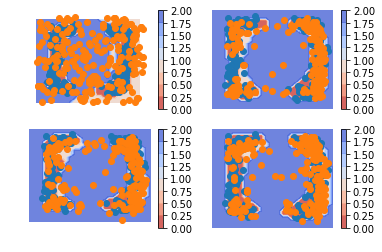

iteration  51
2.3313012 0.066937596 0.79961634 1.4647474


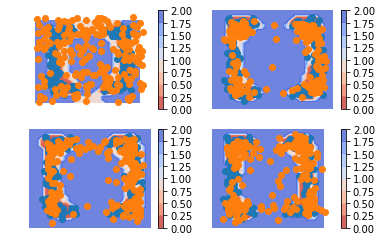

iteration  52
2.8616228 0.06367082 0.81944525 1.9785067


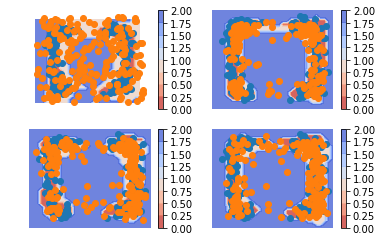

iteration  53
2.6242623 0.062344946 0.8479122 1.7140051


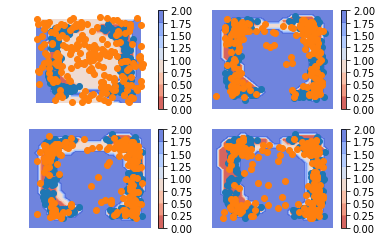

iteration  54
2.3508024 0.06118859 0.83477974 1.4548342


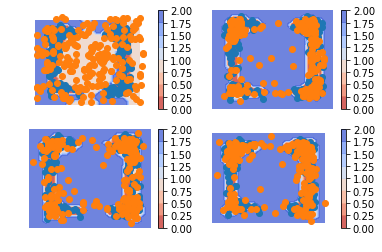

iteration  55
2.4441843 0.060850386 0.82231295 1.5610211


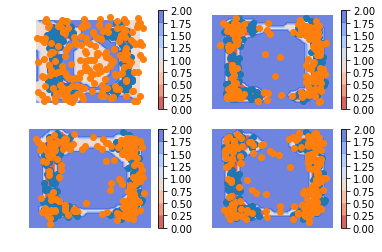

iteration  56
2.7624173 0.05829006 0.8749302 1.8291972


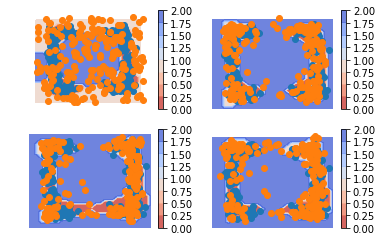

iteration  57
2.5105546 0.060375378 0.88718396 1.5629952


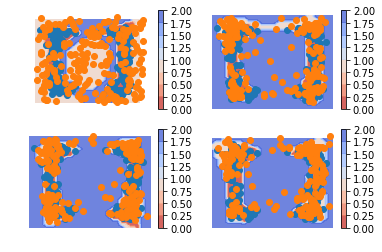

iteration  58
2.5189238 0.060518418 0.8529363 1.6054691


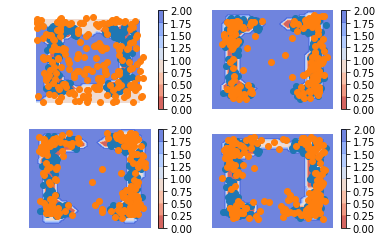

iteration  59
2.7586503 0.06329503 0.81651306 1.8788424


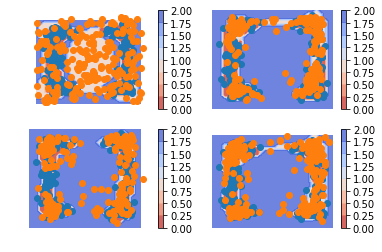

iteration  60
2.3889098 0.06259428 0.8554629 1.4708526


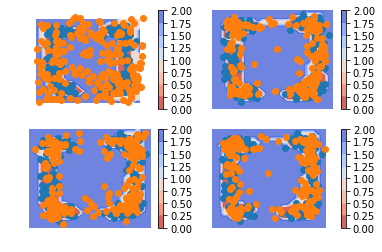

iteration  61
2.1422634 0.06020706 0.8422778 1.2397784


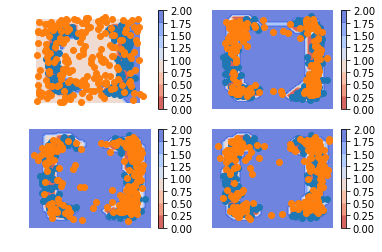

iteration  62
2.4689598 0.06159775 0.8483667 1.5589955


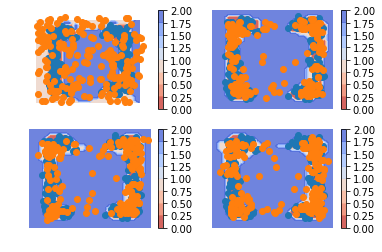

iteration  63
2.2667675 0.058043256 0.7821262 1.4265982


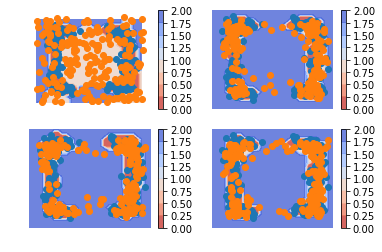

iteration  64
2.3610847 0.05664998 0.8062264 1.4982084


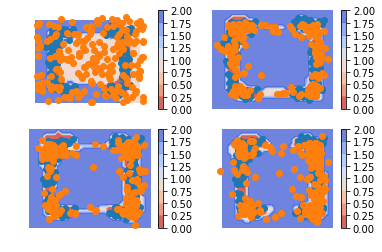

iteration  65
2.8919618 0.057701048 0.81133723 2.0229235


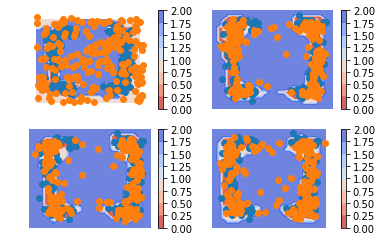

iteration  66
2.7375731 0.060750045 0.8201036 1.8567196


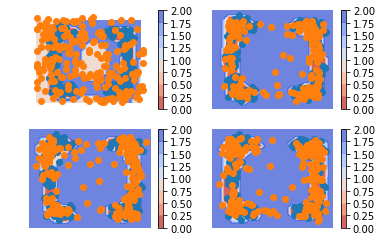

iteration  67
2.301393 0.06391429 0.8322868 1.405192


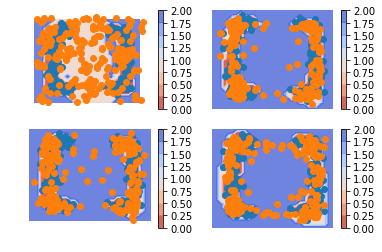

iteration  68
2.58034 0.06663884 0.86866474 1.6450362


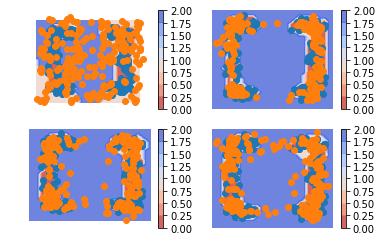

iteration  69
2.2561717 0.076216735 0.8556211 1.3243338


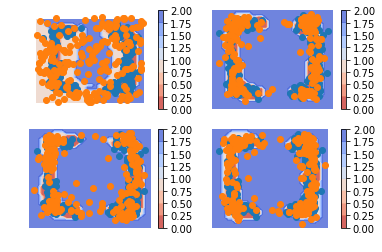

iteration  70
2.0768003 0.07752195 0.8228031 1.1764752


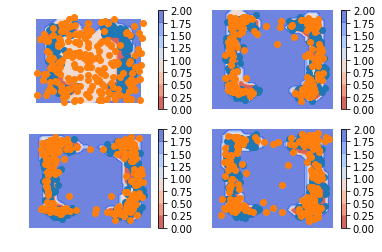

iteration  71
2.3820539 0.08334816 0.82495177 1.473754


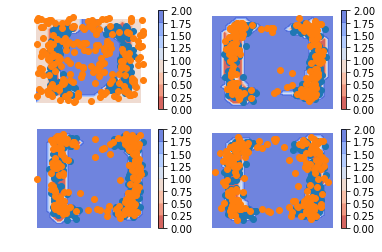

iteration  72
2.4212232 0.08599269 0.8786051 1.4566253


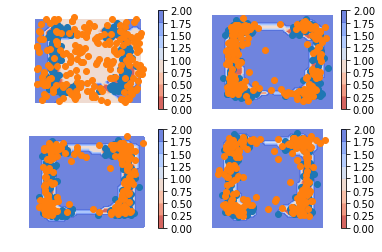

iteration  73
2.1549735 0.08676502 0.841215 1.2269934


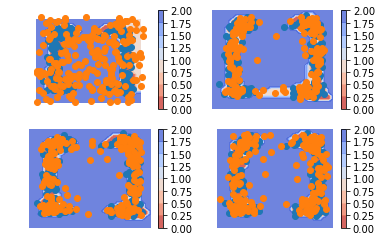

iteration  74
2.327764 0.08350739 0.8785372 1.3657194


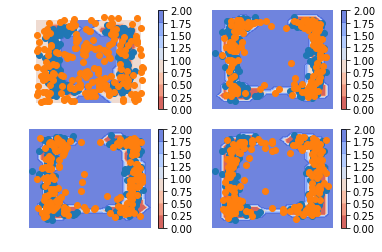

iteration  75
2.1493633 0.08095514 0.80827105 1.2601371


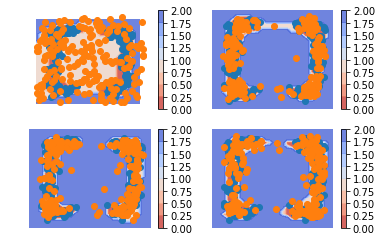

iteration  76
2.1208577 0.07434676 0.83966196 1.206849


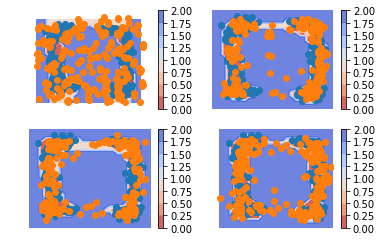

iteration  77
2.3877637 0.07224017 0.84660983 1.4689137


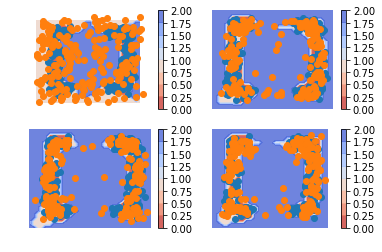

iteration  78
2.8052745 0.06670252 0.87954515 1.8590267


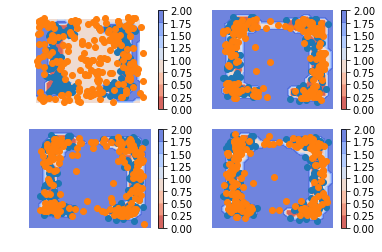

iteration  79
2.3432255 0.06454186 0.8406888 1.4379947


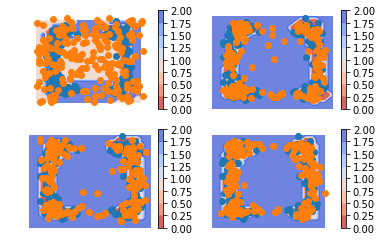

iteration  80
2.2612822 0.061070837 0.85991156 1.3402997


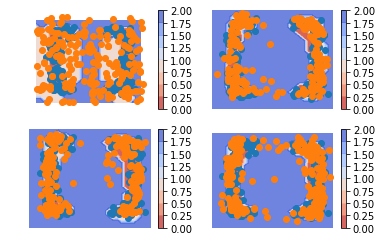

iteration  81
2.5590503 0.057020053 0.82292104 1.6791092


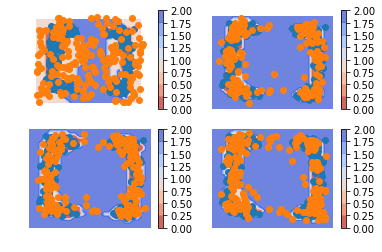

iteration  82
2.7332826 0.055482965 0.85523844 1.8225613


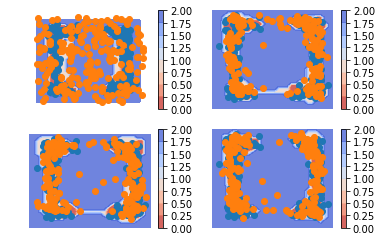

iteration  83
2.6731935 0.05206136 0.79903114 1.822101


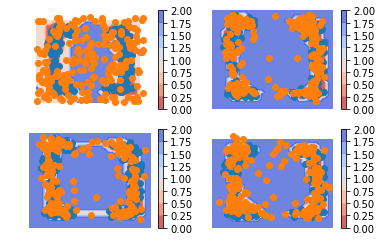

iteration  84
3.0896788 0.04942594 0.87448514 2.1657677


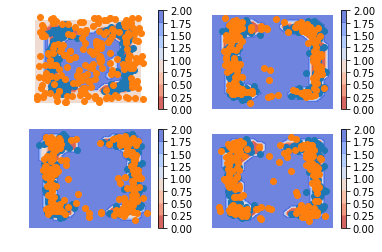

iteration  85
2.2295375 0.048032973 0.8149846 1.3665198


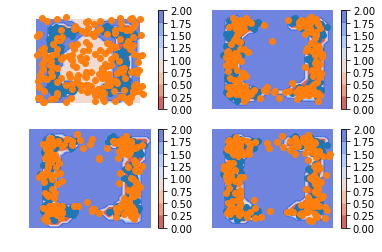

iteration  86
2.2310677 0.044984963 0.85332704 1.3327557


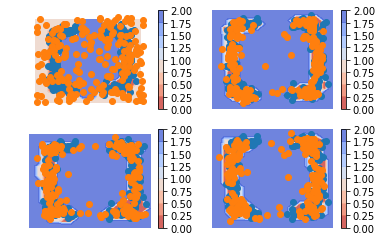

iteration  87
2.3298366 0.04061374 0.8329315 1.4562913


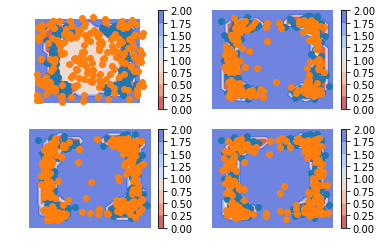

iteration  88
2.2460008 0.038118713 0.82393634 1.3839457


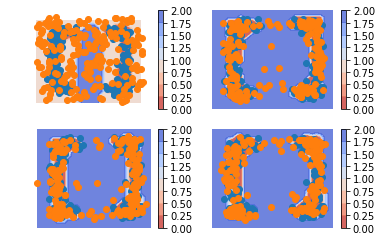

iteration  89
2.5895796 0.03610406 0.8454478 1.7080276


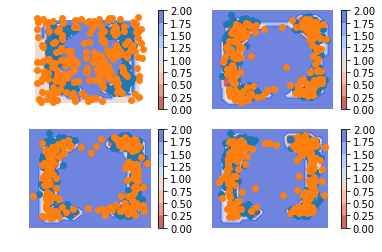

iteration  90
2.1510422 0.034547918 0.8319004 1.2845938


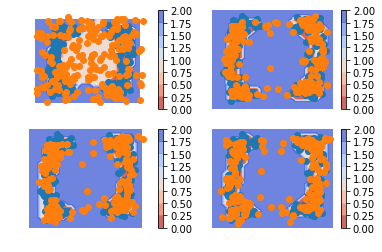

iteration  91
2.166348 0.03525607 0.8408523 1.2902396


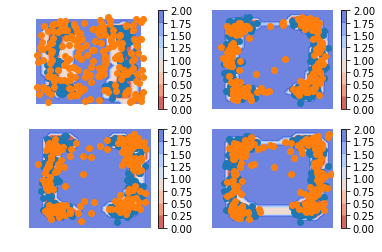

iteration  92
2.4032474 0.03544488 0.8212849 1.5465176


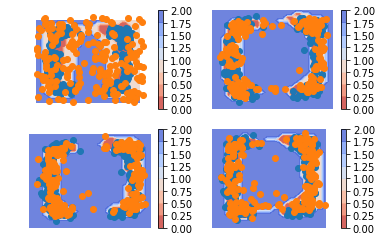

iteration  93
2.3149471 0.035360735 0.8569889 1.4225975


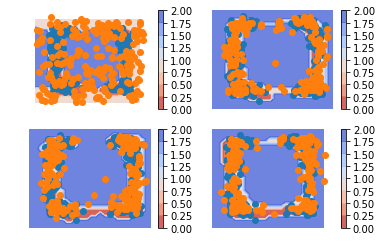

iteration  94
2.3021157 0.03507165 0.8522947 1.4147493


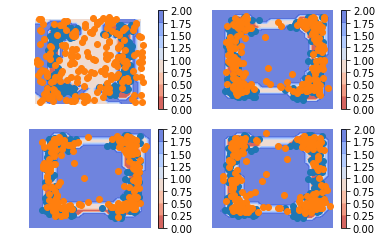

iteration  95
1.9978504 0.035126068 0.81224877 1.1504755


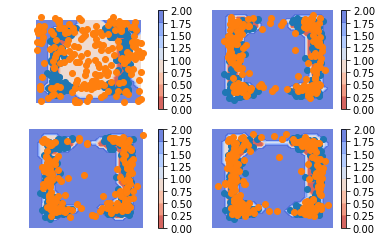

iteration  96
1.9188135 0.034946926 0.84359753 1.040269


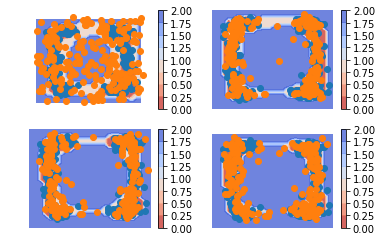

iteration  97
2.175189 0.034472086 0.83928496 1.3014319


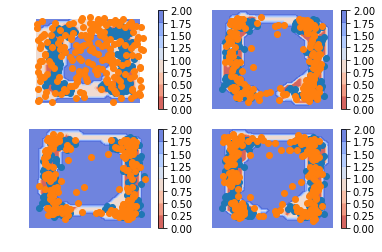

iteration  98
2.2065806 0.03490454 0.85801744 1.3136587


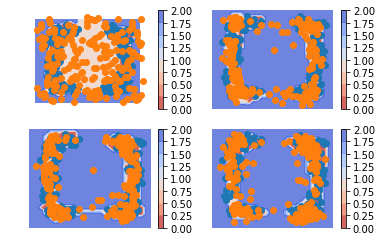

iteration  99
2.519863 0.033991177 0.8212187 1.664653


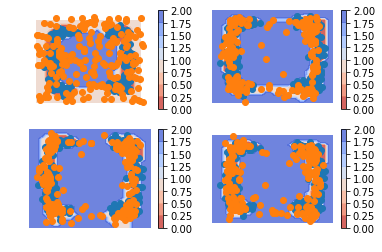

iteration  100
2.599764 0.033012252 0.82126415 1.7454877


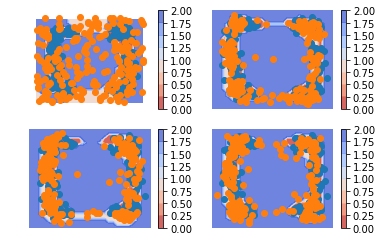

iteration  101
2.3730164 0.03426169 0.81495726 1.5237974


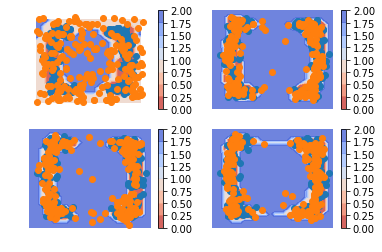

iteration  102
2.5293498 0.032524593 0.83820844 1.6586169


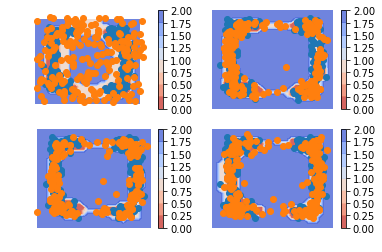

iteration  103
2.2445002 0.031412628 0.8350876 1.3779999


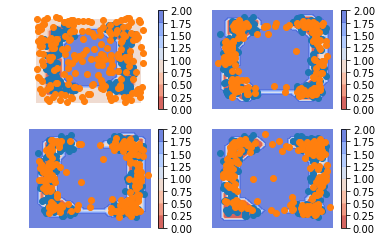

iteration  104
2.2608447 0.03007536 0.83298135 1.397788


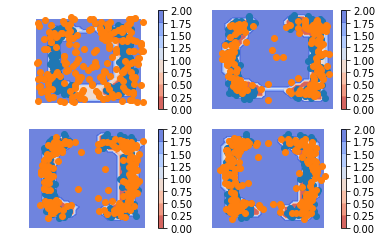

iteration  105
2.5500042 0.02783549 0.82173055 1.7004383


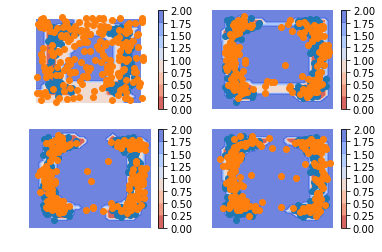

iteration  106
2.5232778 0.02596333 0.8536664 1.6436481


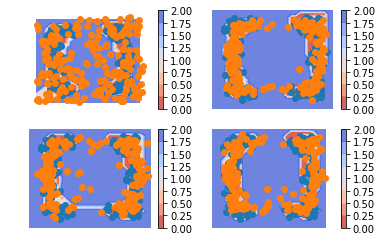

iteration  107
2.3485785 0.025469027 0.83100283 1.4921067


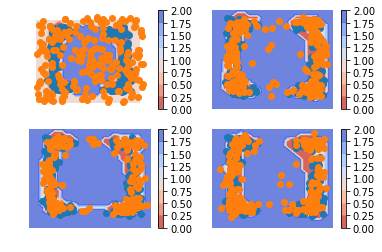

iteration  108
2.5145273 0.024829594 0.85459256 1.6351051


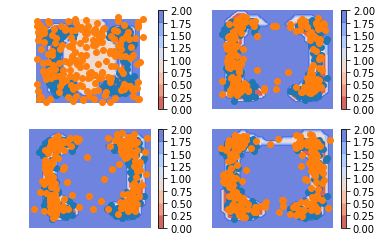

iteration  109
2.4773407 0.027259728 0.84318054 1.6069003


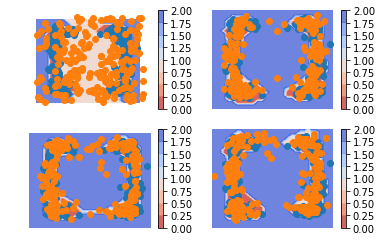

iteration  110
2.1257112 0.0273668 0.832981 1.2653633


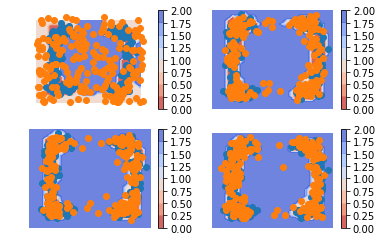

iteration  111
2.2300198 0.026852971 0.81061393 1.3925529


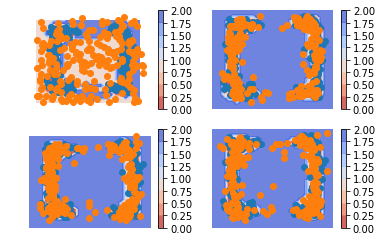

iteration  112
2.4374976 0.029215628 0.8440918 1.5641901


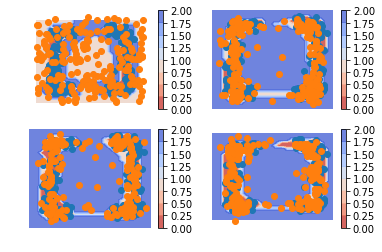

iteration  113
2.105515 0.033322725 0.8377704 1.2344218


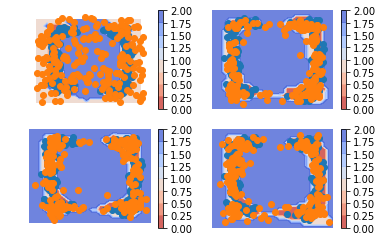

iteration  114
2.34547 0.033596415 0.85259116 1.4592824


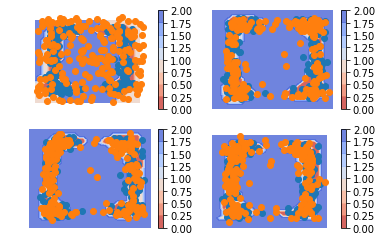

iteration  115
1.9127828 0.039138634 0.84816414 1.02548


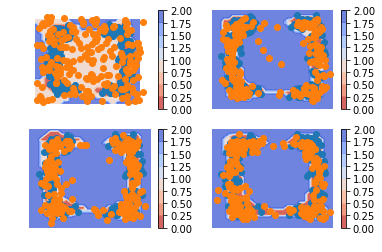

iteration  116
2.0342846 0.03893708 0.8594918 1.1358556


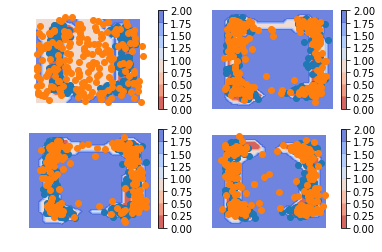

iteration  117
2.3225322 0.041153725 0.85134727 1.4300311


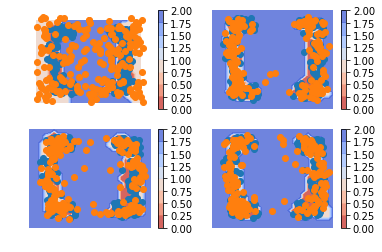

iteration  118
2.413814 0.040285617 0.8384781 1.5350503


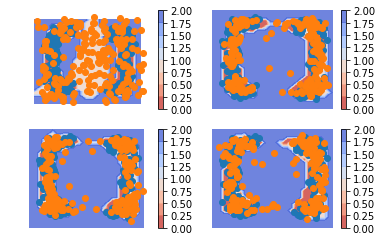

iteration  119
2.0932887 0.040879533 0.8615431 1.190866


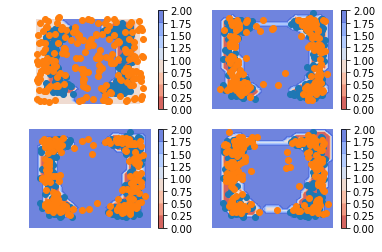

iteration  120
2.3892355 0.043965176 0.84557176 1.4996985


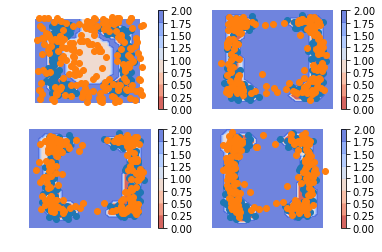

iteration  121
2.1817298 0.054070264 0.82582486 1.3018346


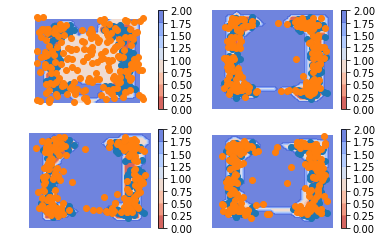

iteration  122
2.554659 0.05951945 0.8322153 1.6629242


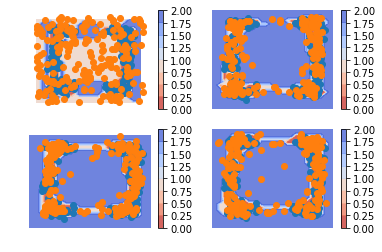

iteration  123
2.310785 0.07562026 0.82789147 1.4072734


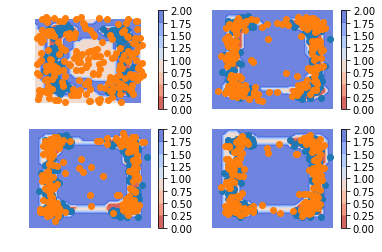

iteration  124
2.6311455 0.10202477 0.84356904 1.6855516


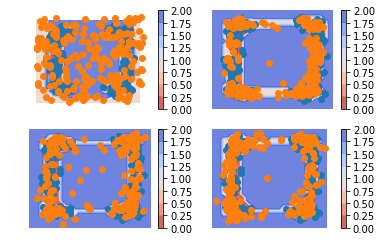

iteration  125
2.7204916 0.12194378 0.84931165 1.7492362


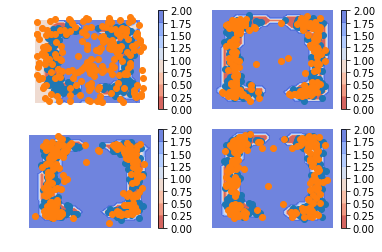

iteration  126
2.3465197 0.12032065 0.8410077 1.3851913


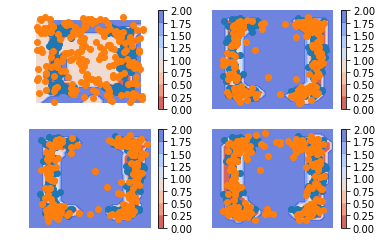

iteration  127
2.6572194 0.15873393 0.81886905 1.6796165


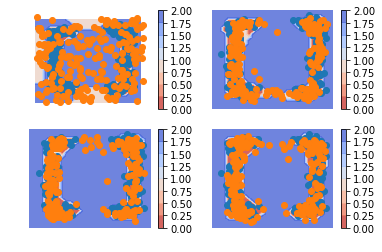

iteration  128
2.6589668 0.14944254 0.83490485 1.6746193


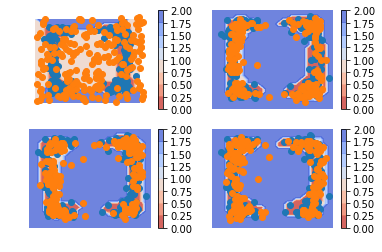

iteration  129
2.1844125 0.1257047 0.8183559 1.2403519


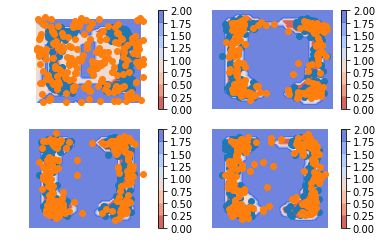

iteration  130
2.2674448 0.121539705 0.84830344 1.2976017


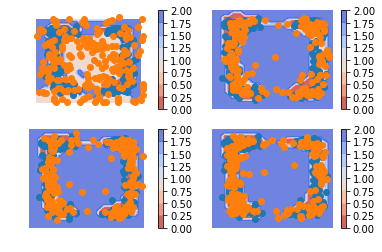

iteration  131
2.3075159 0.09488144 0.8415258 1.3711087


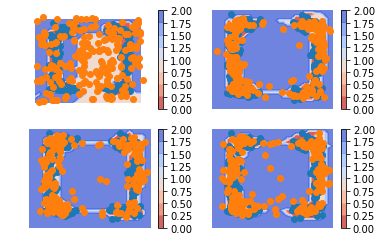

iteration  132
2.5059576 0.0853239 0.85046107 1.5701728


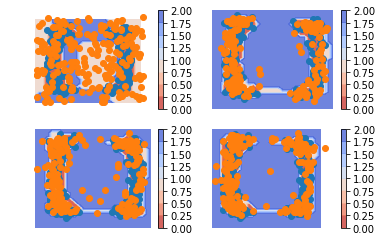

iteration  133
2.8153572 0.07688455 0.85642433 1.8820484


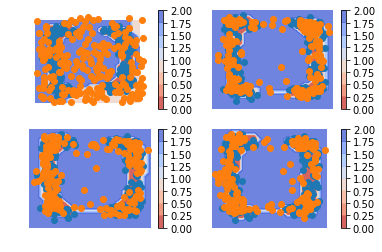

iteration  134
2.3968587 0.05603969 0.84667945 1.4941397


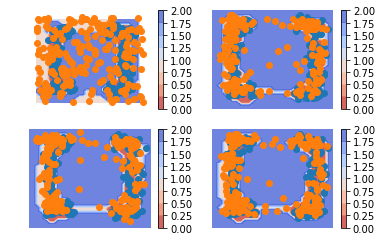

iteration  135
2.812845 0.045077886 0.8510401 1.9167271


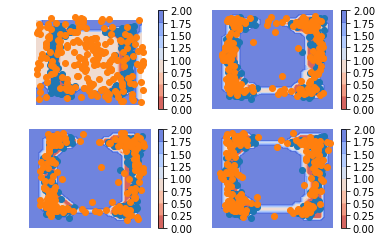

iteration  136
2.4232528 0.041939188 0.8416498 1.5396638


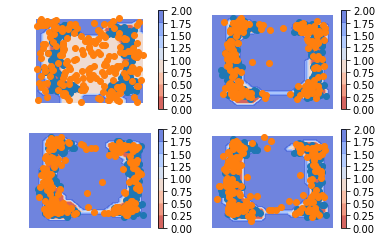

iteration  137
2.544883 0.037711777 0.82055724 1.6866139


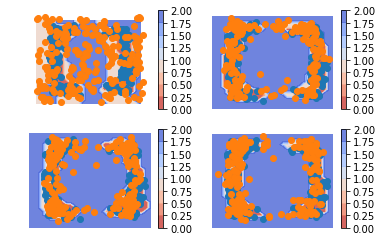

iteration  138
2.044387 0.04004078 0.84220874 1.1621376


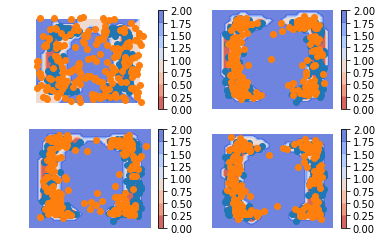

iteration  139
2.1982245 0.035578545 0.86287457 1.2997713


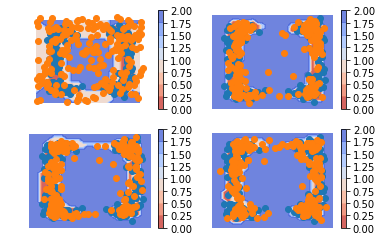

iteration  140
2.327568 0.037584964 0.8277958 1.4621872


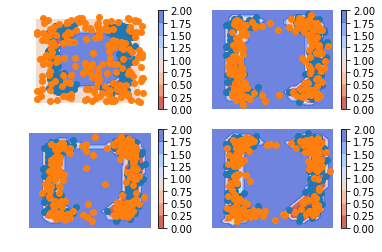

iteration  141
2.2143059 0.037603587 0.8360245 1.3406779


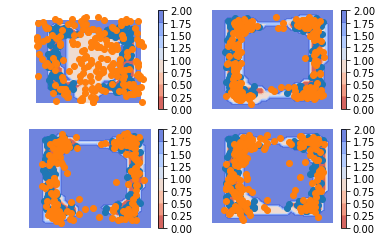

iteration  142
2.00237 0.038237657 0.8210411 1.1430913


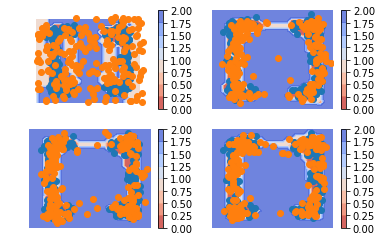

iteration  143
2.47657 0.036600463 0.8458396 1.5941298


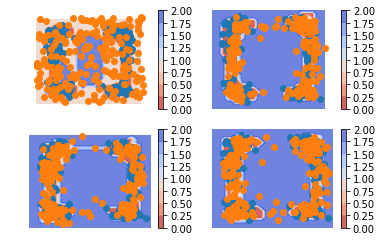

iteration  144
2.203139 0.036945045 0.8061826 1.3600113


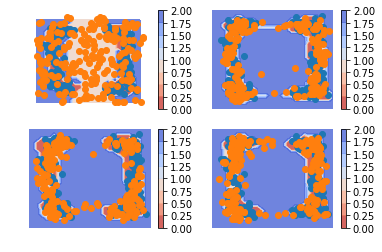

iteration  145
2.366204 0.036373436 0.8163359 1.5134946


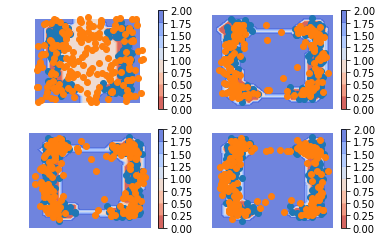

iteration  146
2.5651314 0.03458125 0.882404 1.6481462


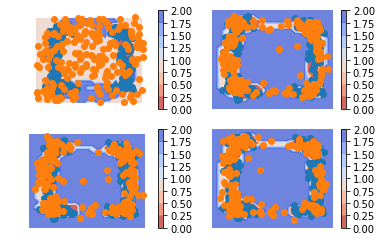

iteration  147
2.5055108 0.032609157 0.8197884 1.6531131


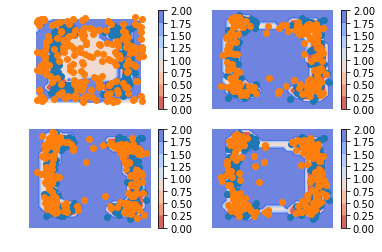

iteration  148
2.406705 0.030724745 0.7993791 1.5766011


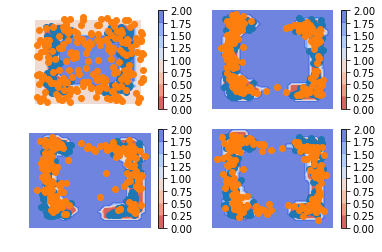

iteration  149
3.0133944 0.032430142 0.8364846 2.1444798


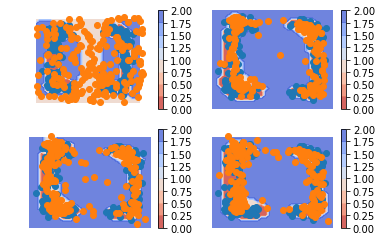

iteration  150
2.5008113 0.031657398 0.837215 1.6319389


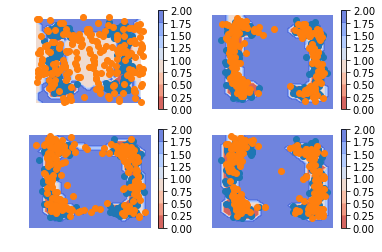

iteration  151
2.6119466 0.034189846 0.8326323 1.7451245


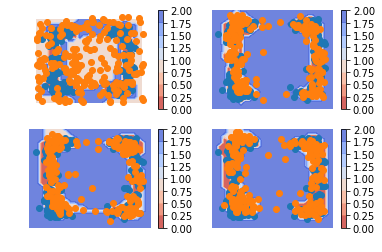

iteration  152
2.4473672 0.03552502 0.84778535 1.5640568


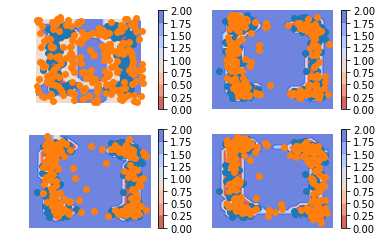

iteration  153
2.3675919 0.035685774 0.81220454 1.5197015


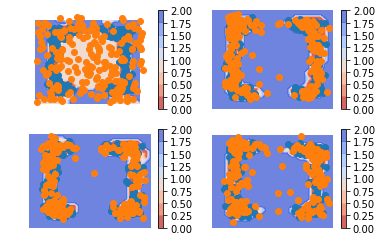

iteration  154
2.416079 0.036489 0.8119949 1.567595


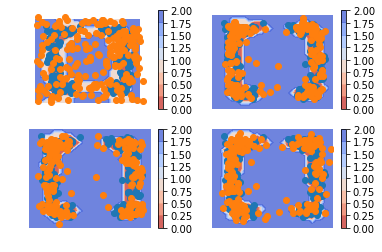

iteration  155
2.5660708 0.03896923 0.87247896 1.6546226


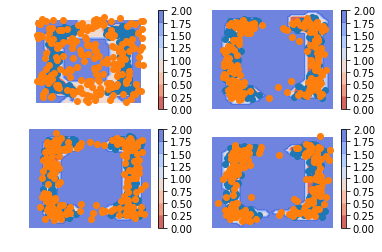

iteration  156
2.7934017 0.0410288 0.81392246 1.9384506


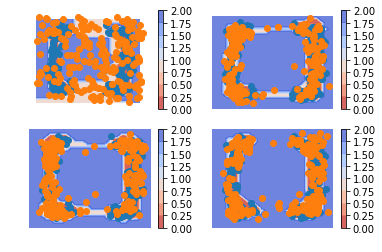

iteration  157
3.0125103 0.04744921 0.8297318 2.1353292


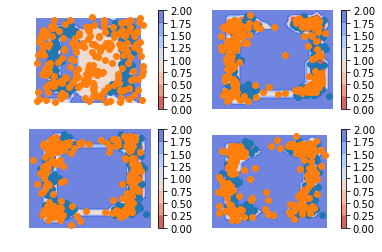

iteration  158
2.7676475 0.053709194 0.82897794 1.8849603


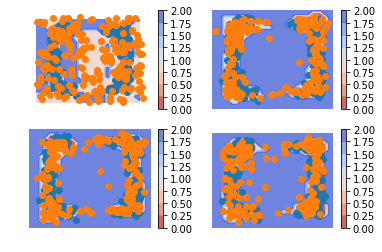

iteration  159
2.841247 0.061486874 0.80688435 1.972876


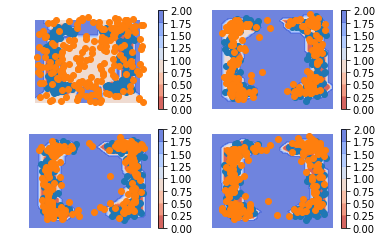

iteration  160
2.4022002 0.06514782 0.82532567 1.5117269


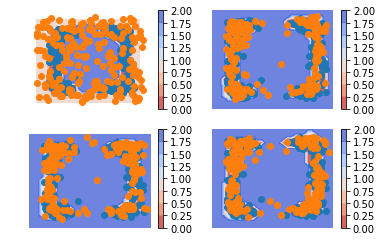

iteration  161
2.481563 0.06846087 0.8389375 1.5741646


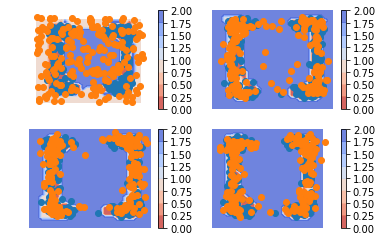

iteration  162
2.3131545 0.06988046 0.8252611 1.4180129


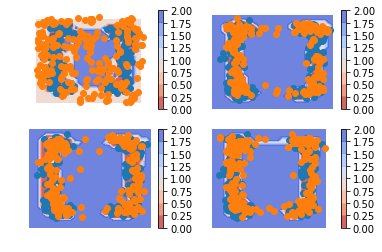

iteration  163
2.310274 0.0703832 0.8304494 1.4094414


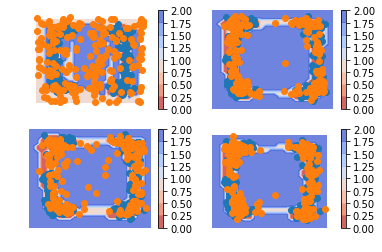

iteration  164
2.9279459 0.0676337 0.8817879 1.9785243


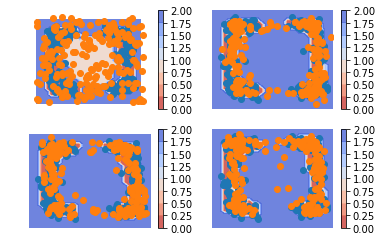

iteration  165
1.9475781 0.06768987 0.8413551 1.0385331


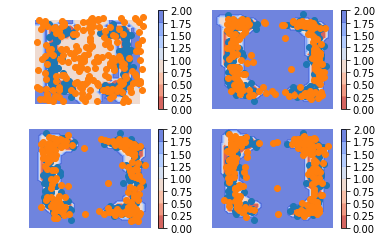

iteration  166
2.2038643 0.06943762 0.8115226 1.3229041


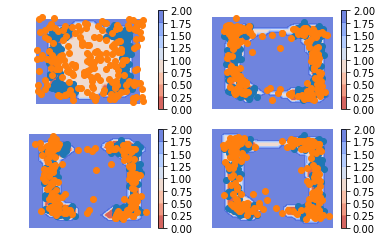

iteration  167
2.5582252 0.0709015 0.8249972 1.6623265


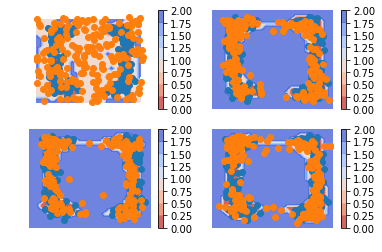

iteration  168
2.6513867 0.070953295 0.8286871 1.7517464


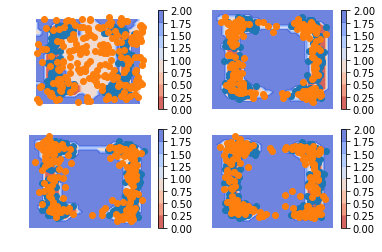

iteration  169
2.3055115 0.07443713 0.8336922 1.3973823


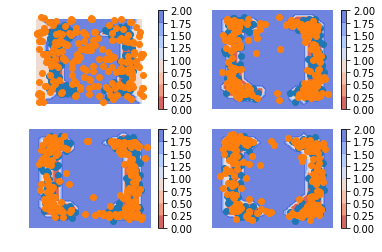

iteration  170
2.422659 0.07828278 0.81801885 1.5263572


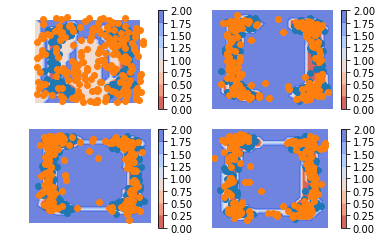

iteration  171
2.604951 0.07608186 0.8016633 1.7272056


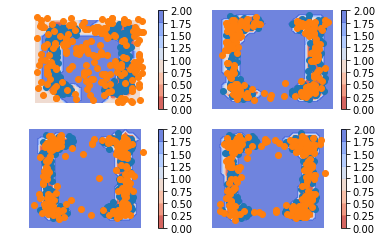

iteration  172
2.4318333 0.0724965 0.8592087 1.5001279


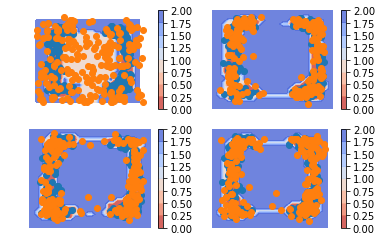

iteration  173
2.419369 0.0734099 0.8339201 1.512039


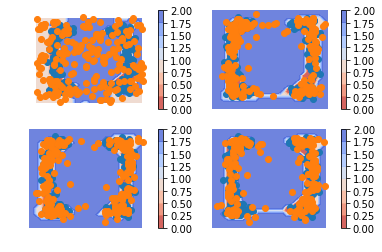

iteration  174
2.7371492 0.073882334 0.83874214 1.8245248


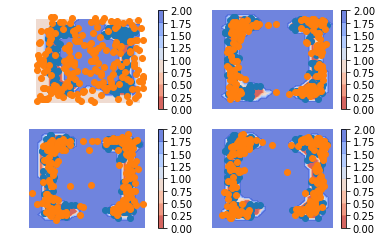

iteration  175
2.6200786 0.07262848 0.8434807 1.7039694


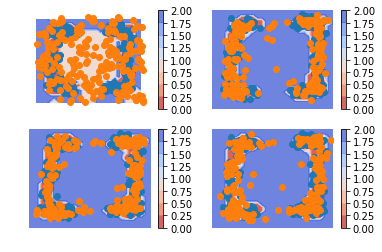

iteration  176
2.4001365 0.07361956 0.8430894 1.4834276


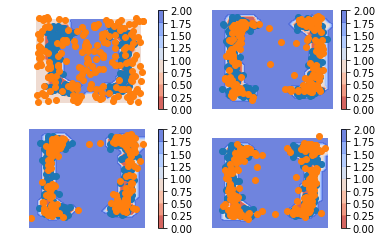

iteration  177
2.5623496 0.07652886 0.793206 1.6926147


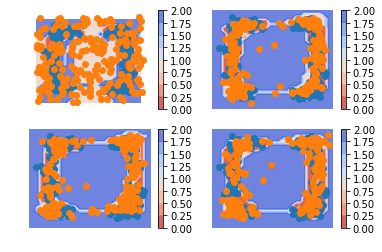

iteration  178
2.4324617 0.07547139 0.78522444 1.5717659


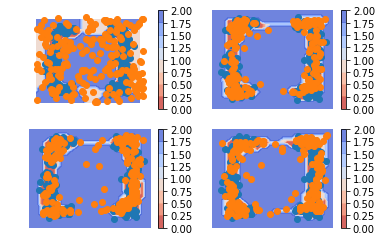

iteration  179
2.9210205 0.07579925 0.8157431 2.0294783


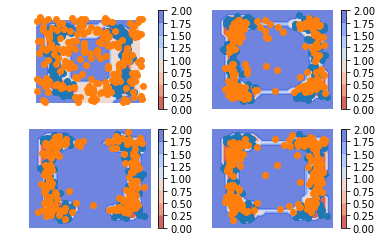

iteration  180
2.7449028 0.07144206 0.87378716 1.7996737


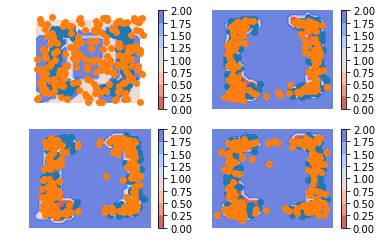

iteration  181
2.0836143 0.0647436 0.8590056 1.1598653


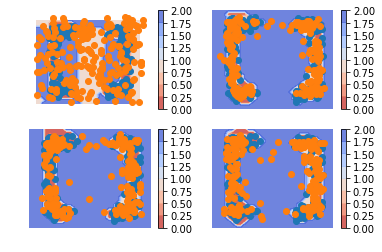

iteration  182
2.3673942 0.059105497 0.8486866 1.4596021


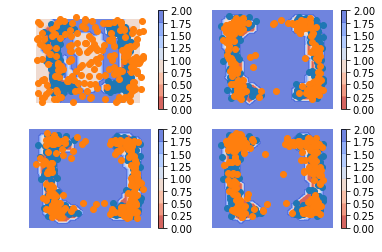

iteration  183
2.716666 0.055251986 0.84808064 1.8133334


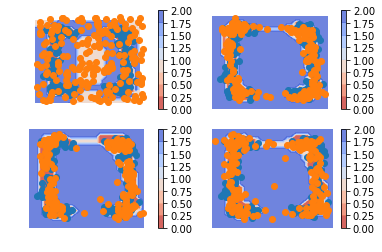

iteration  184
2.1555061 0.051993456 0.8459722 1.2575405


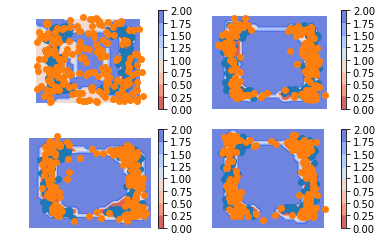

iteration  185
2.3816926 0.048594236 0.8067731 1.5263253


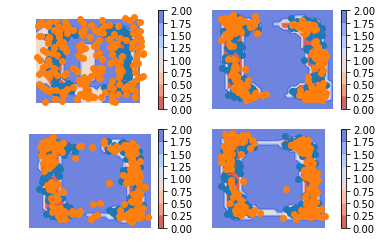

iteration  186
2.130919 0.04998989 0.8668411 1.2140881


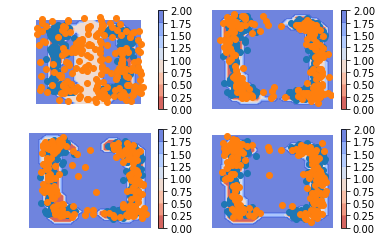

iteration  187
2.3574314 0.044890776 0.83069897 1.4818417


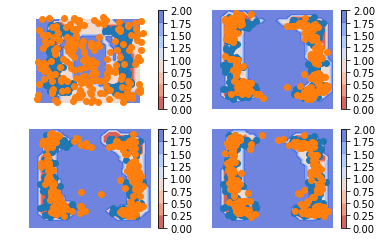

iteration  188
2.3890526 0.047141943 0.85885763 1.483053


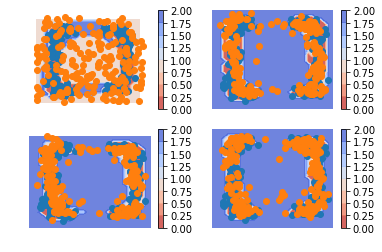

iteration  189
2.4374816 0.045152634 0.83207345 1.5602555


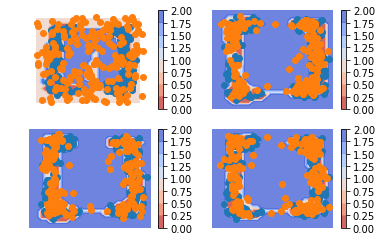

iteration  190
2.4700139 0.05074292 0.789827 1.629444


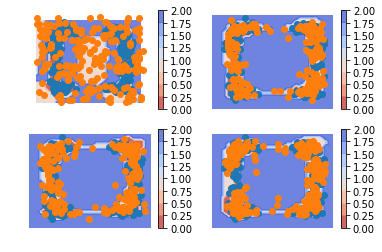

iteration  191
2.7506523 0.05449906 0.84000945 1.8561438


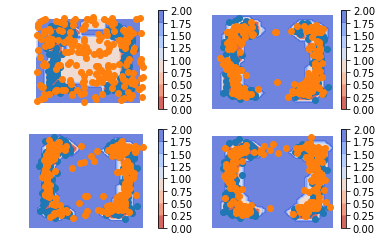

iteration  192
2.5389168 0.053574402 0.82338226 1.6619602


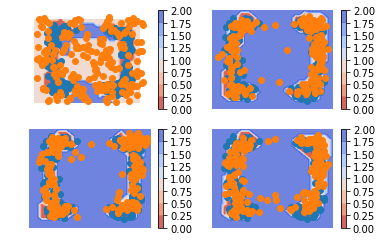

iteration  193
2.587966 0.0565941 0.8525048 1.6788671


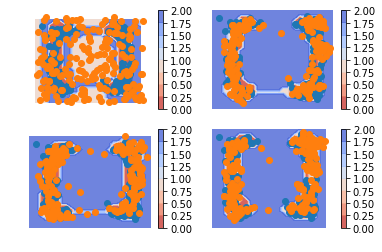

iteration  194
2.4452038 0.060404677 0.8577444 1.5270548


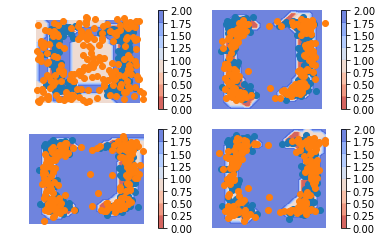

iteration  195
2.1287394 0.062214915 0.8431829 1.2233416


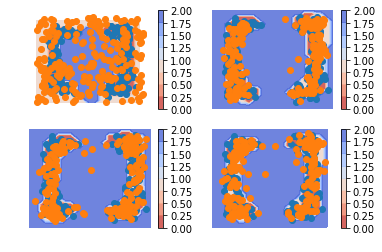

iteration  196
2.0145724 0.06570935 0.80687416 1.1419889


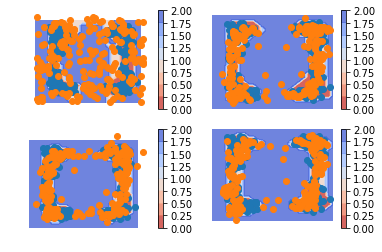

iteration  197
2.2487128 0.06295354 0.8374815 1.3482777


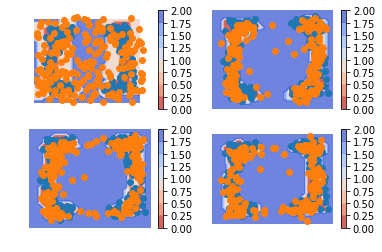

iteration  198
2.5175796 0.0690639 0.8522422 1.5962735


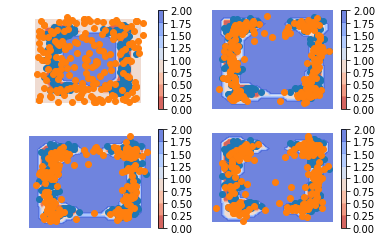

iteration  199
2.2120457 0.066913456 0.8136095 1.3315228


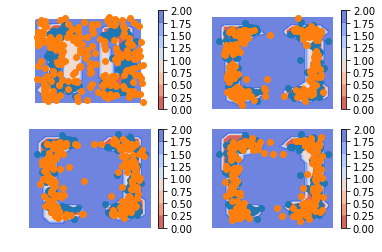

iteration  200
2.0428495 0.06696265 0.81084454 1.1650424


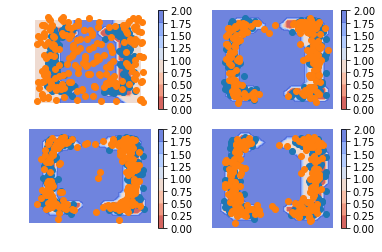

iteration  201
2.1637774 0.070086844 0.85412776 1.2395626


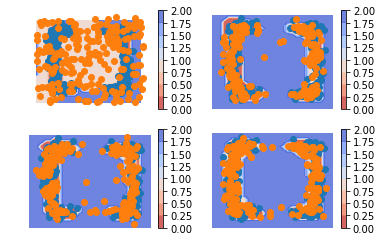

iteration  202
2.2219343 0.062102914 0.8084303 1.3514011


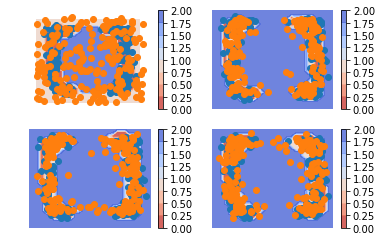

iteration  203
2.2573397 0.066728525 0.83269095 1.3579203


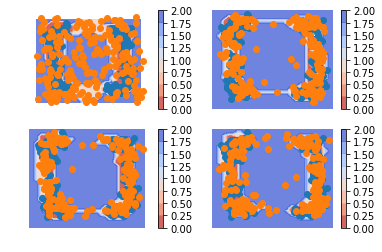

iteration  204
2.3254313 0.06166038 0.8454017 1.4183693


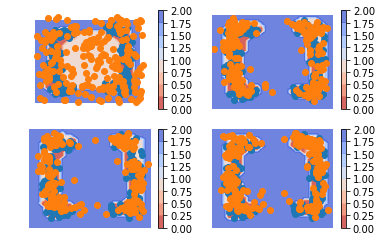

iteration  205
2.3863492 0.059870757 0.8377397 1.4887387


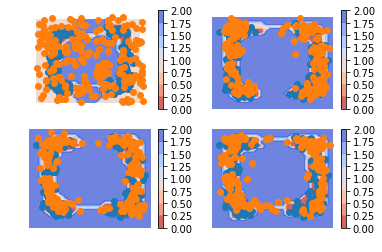

iteration  206
2.3089342 0.051355597 0.85866904 1.3989097


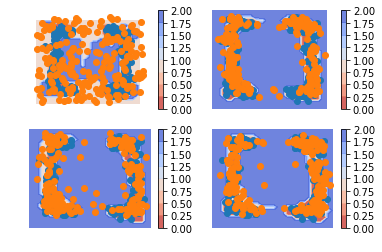

iteration  207
2.3037126 0.052325167 0.82843196 1.4229554


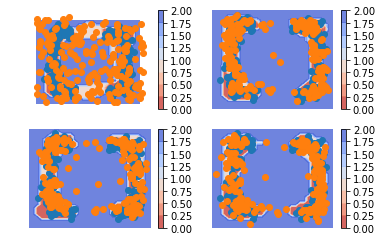

iteration  208
2.451302 0.047891587 0.86442274 1.5389878


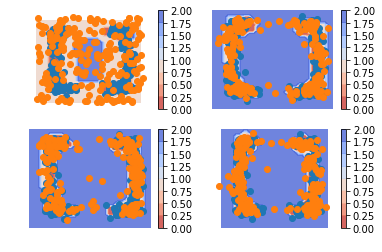

iteration  209
2.327924 0.043782867 0.8404882 1.4436529


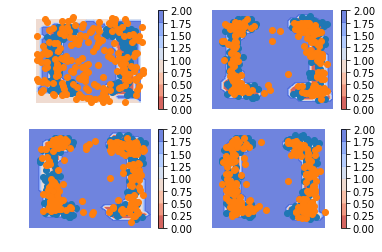

iteration  210
2.043855 0.043766055 0.78341097 1.2166779


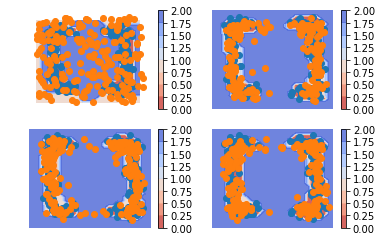

iteration  211
2.2024782 0.04036218 0.8051555 1.3569604


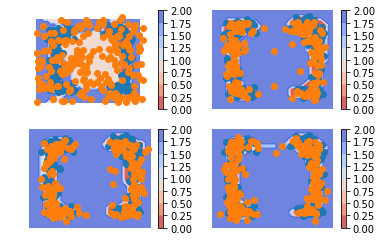

iteration  212
2.3967981 0.037970625 0.84192824 1.5168993


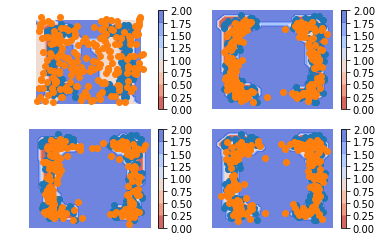

iteration  213
2.2420235 0.03763439 0.8251922 1.379197


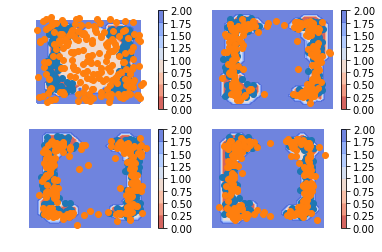

iteration  214
2.7106276 0.03366101 0.8076328 1.8693337


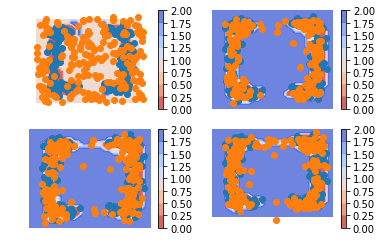

iteration  215
2.4557738 0.034168556 0.856183 1.5654222


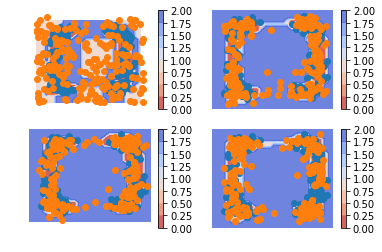

iteration  216
2.532096 0.034722656 0.86195767 1.6354157


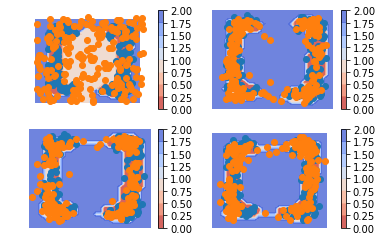

iteration  217
2.0540814 0.03413504 0.8408536 1.1790928


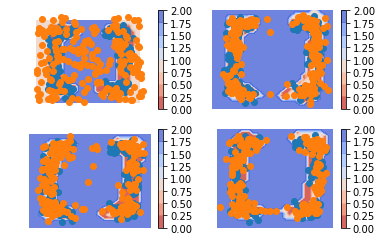

iteration  218
1.8732134 0.03371907 0.8295808 1.0099136


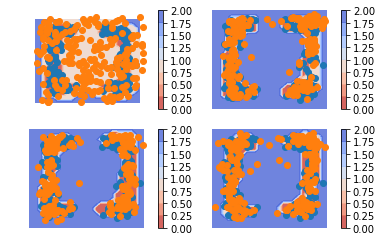

iteration  219
2.314885 0.03522626 0.8175237 1.462135


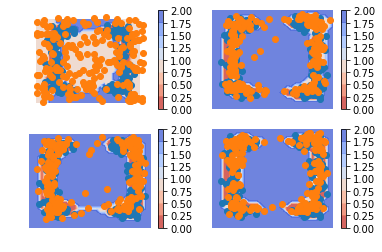

iteration  220
2.7573354 0.03636996 0.8533081 1.8676574


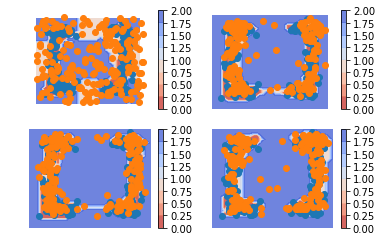

iteration  221
2.1276586 0.037654825 0.8206134 1.2693905


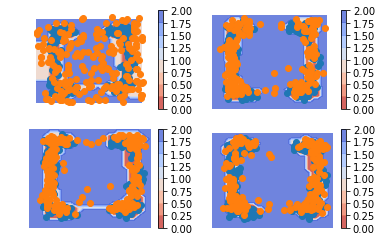

iteration  222
2.541589 0.038908873 0.82727206 1.675408


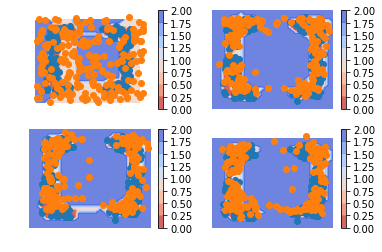

iteration  223
2.5332727 0.03909685 0.8527882 1.6413876


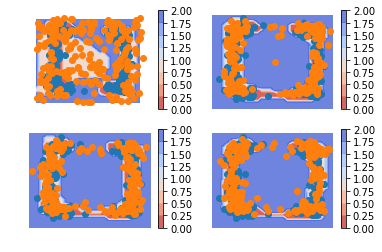

iteration  224
1.9040263 0.03993761 0.81733185 1.0467567


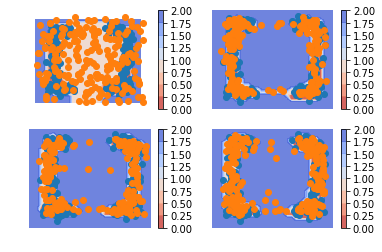

iteration  225
2.5103765 0.04095073 0.8700731 1.5993526


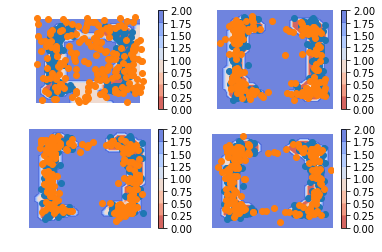

iteration  226
2.0519843 0.038549937 0.82334006 1.1900944


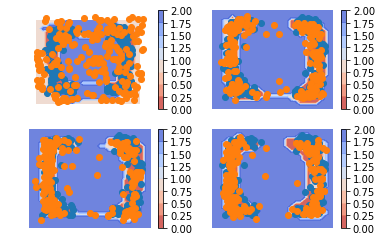

iteration  227
2.2565403 0.039955143 0.8006629 1.4159222


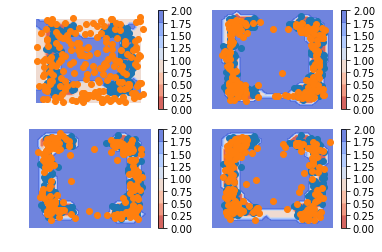

iteration  228
2.545913 0.037928764 0.83605045 1.6719338


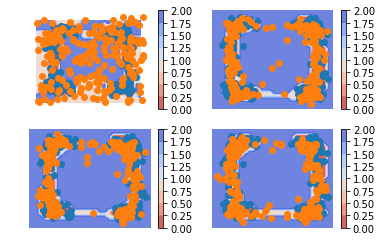

iteration  229
2.7863462 0.040690538 0.8833558 1.8622998


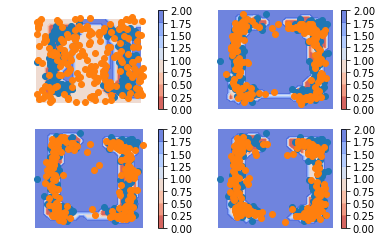

iteration  230
1.9215145 0.03888682 0.826682 1.0559456


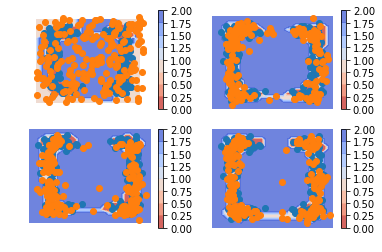

iteration  231
2.274063 0.03973254 0.84680134 1.3875294


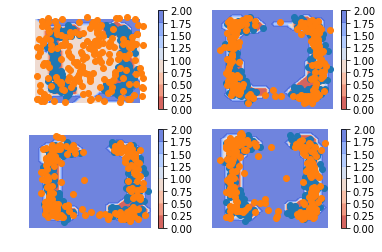

iteration  232
1.9777962 0.03768108 0.8649272 1.0751879


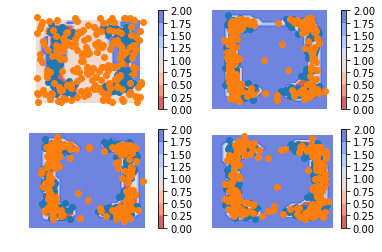

iteration  233
2.33775 0.037375808 0.8257815 1.4745926


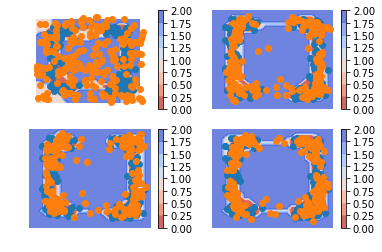

iteration  234
2.5613866 0.0341344 0.80486417 1.7223879


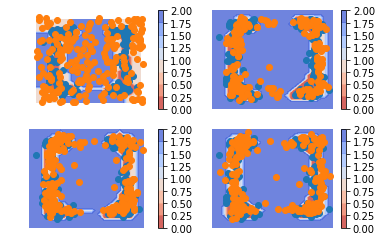

iteration  235
2.6862247 0.033028092 0.83800304 1.8151935


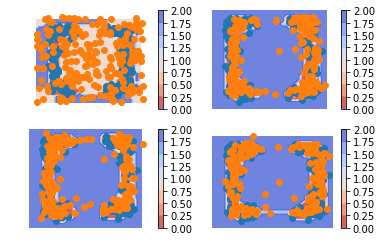

iteration  236
2.3530796 0.03125002 0.8543972 1.4674324


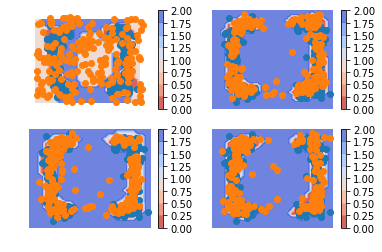

iteration  237
2.2707255 0.027591906 0.8305948 1.4125388


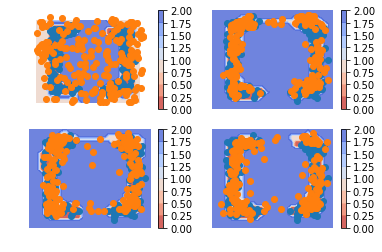

iteration  238
2.1754308 0.023828251 0.8119252 1.3396773


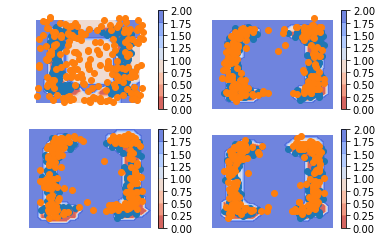

iteration  239
2.3357043 0.021821864 0.86757267 1.4463097


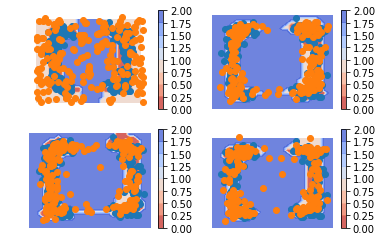

iteration  240
2.4019926 0.018815434 0.86446655 1.5187105


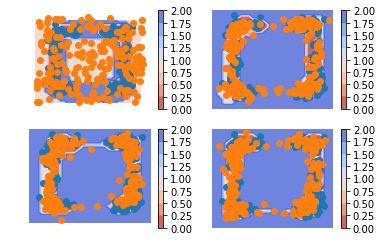

iteration  241
2.5453463 0.017466603 0.80290425 1.7249753


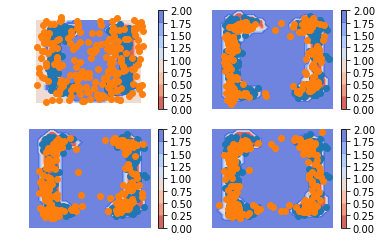

iteration  242
2.1561904 0.016480375 0.8184265 1.3212836


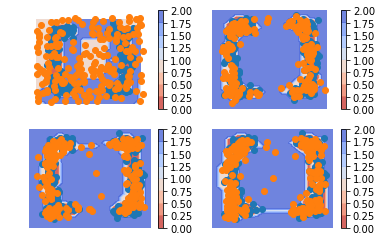

iteration  243
2.6294272 0.016374698 0.8322231 1.7808294


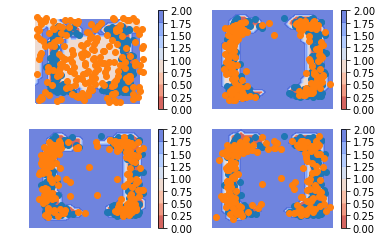

iteration  244
2.2672594 0.016295847 0.8229866 1.4279768


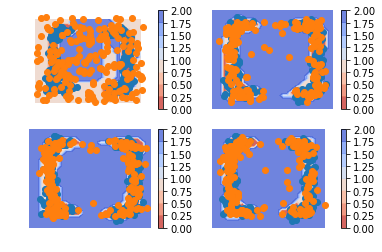

iteration  245
2.5610476 0.016002722 0.8281313 1.7169135


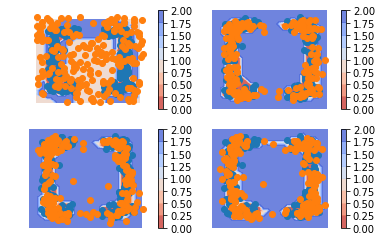

iteration  246
2.0072432 0.01618411 0.83141303 1.1596462


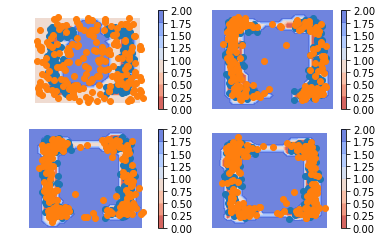

iteration  247
2.3435616 0.014972417 0.8282317 1.5003576


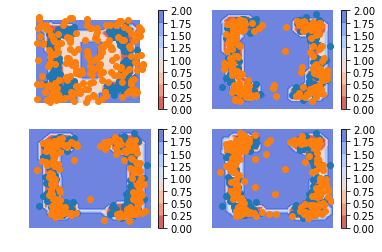

iteration  248
1.9290521 0.014265965 0.8389394 1.0758467


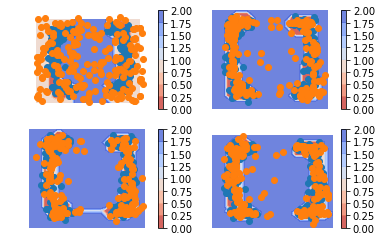

iteration  249
2.7511127 0.0127237635 0.8572241 1.8811649


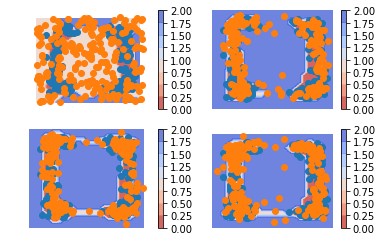

iteration  250
2.2578106 0.012334269 0.83484054 1.4106358


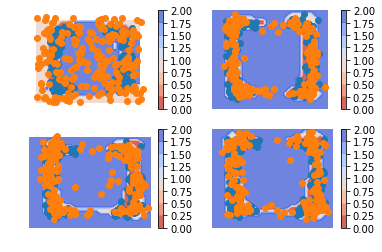

iteration  251
2.4890218 0.011055203 0.8228953 1.6550714


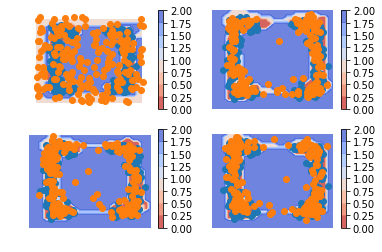

iteration  252
2.0897832 0.011040512 0.8362854 1.2424572


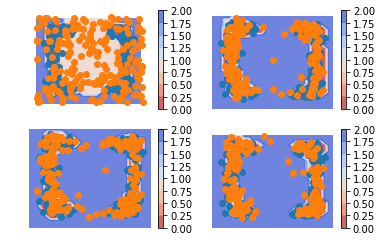

iteration  253
2.9653008 0.010917297 0.81012625 2.1442573


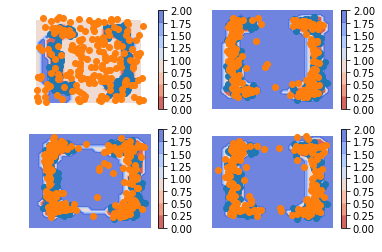

iteration  254
2.4189963 0.011431754 0.82389504 1.5836697


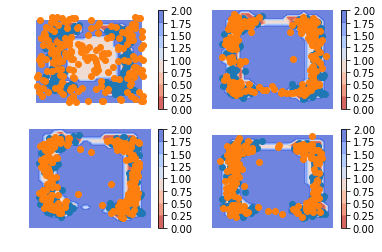

iteration  255
2.1351976 0.011886258 0.8511934 1.2721181


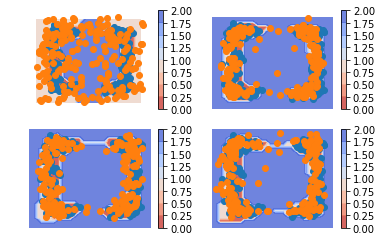

iteration  256
2.2870605 0.011930788 0.872895 1.4022347


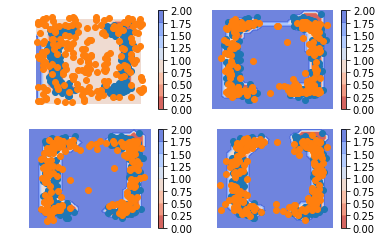

iteration  257
2.437971 0.01294995 0.8456545 1.5793666


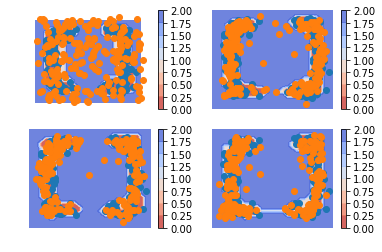

iteration  258
2.28691 0.013409961 0.8184614 1.4550385


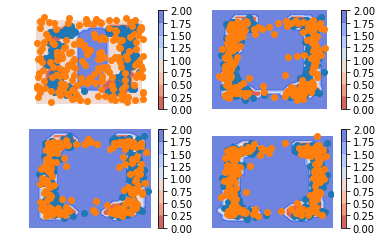

iteration  259
2.239772 0.01403067 0.8389239 1.3868175


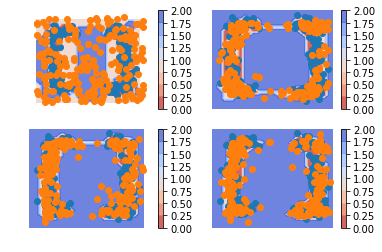

iteration  260
2.235398 0.013695643 0.85560954 1.3660928


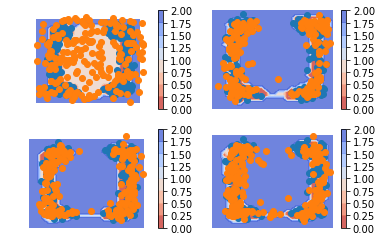

iteration  261
2.1630647 0.013946218 0.8321744 1.3169441


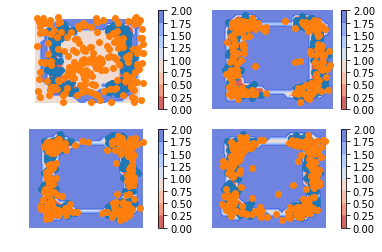

iteration  262
2.3208625 0.014911424 0.8688353 1.4371159


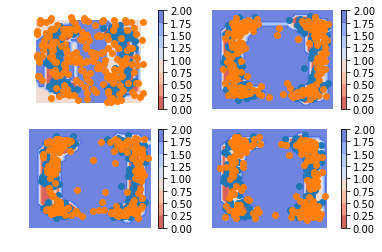

iteration  263
2.0565796 0.015029008 0.8327489 1.2088016


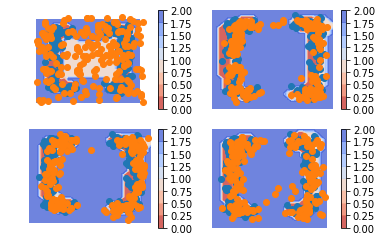

iteration  264
2.522249 0.015685616 0.8445084 1.6620549


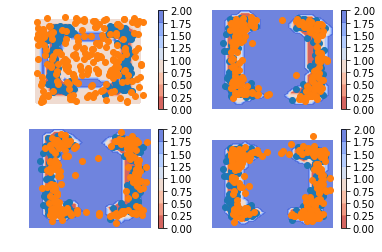

iteration  265
2.3719964 0.016636204 0.8237305 1.5316298


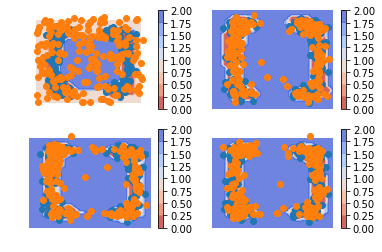

iteration  266
2.2215447 0.016615592 0.82441425 1.380515


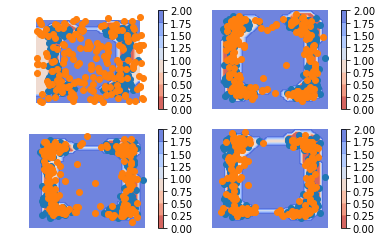

iteration  267
2.2688618 0.017385222 0.844416 1.4070605


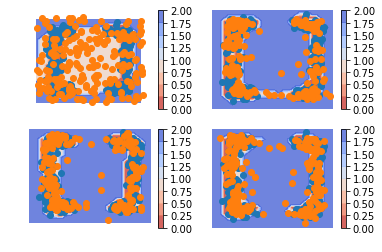

iteration  268
2.1737318 0.017402863 0.8492693 1.3070595


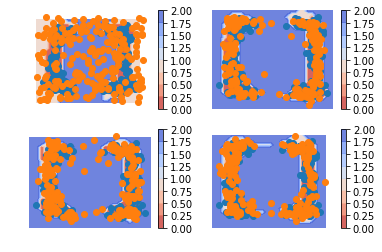

iteration  269
2.0300763 0.017892176 0.8352629 1.1769211


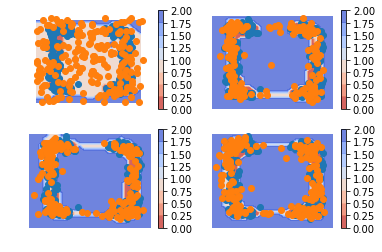

iteration  270
2.173052 0.01794401 0.8104809 1.3446271


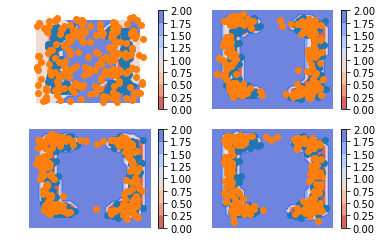

iteration  271
2.506709 0.017501034 0.81698906 1.672219


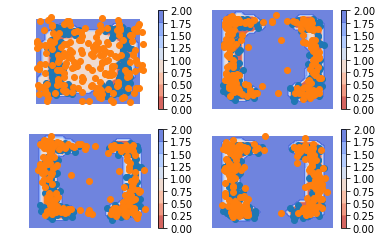

iteration  272
2.20312 0.017076448 0.81233716 1.3737065


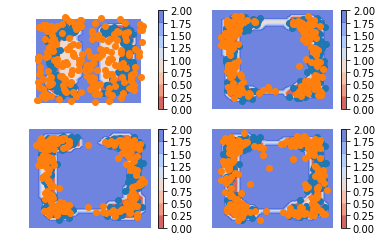

iteration  273
2.1786668 0.016304715 0.84553176 1.3168304


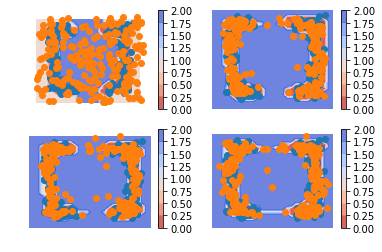

iteration  274
2.1508718 0.015543928 0.82592076 1.3094071


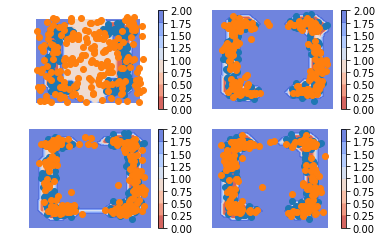

iteration  275
2.3165815 0.014739619 0.88210267 1.4197391


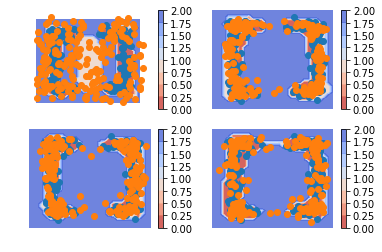

iteration  276
2.1096196 0.013784299 0.8362795 1.2595558


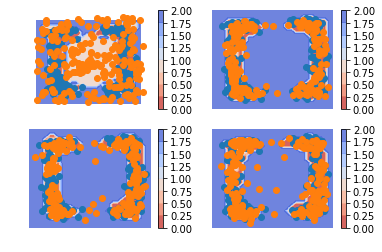

iteration  277
2.00169 0.013371706 0.8058567 1.1824615


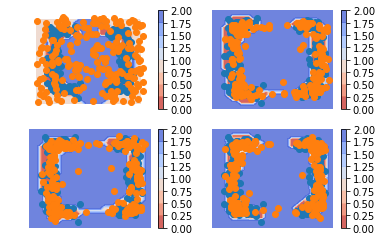

iteration  278
2.1484475 0.013037437 0.822996 1.3124142


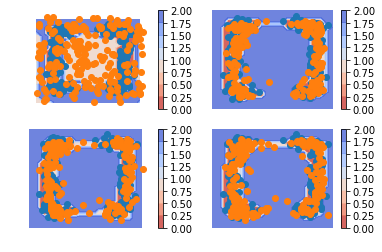

iteration  279
2.05514 0.0125343315 0.79969645 1.2429092


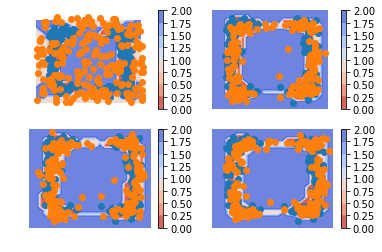

iteration  280
2.0585186 0.012906808 0.803915 1.2416968


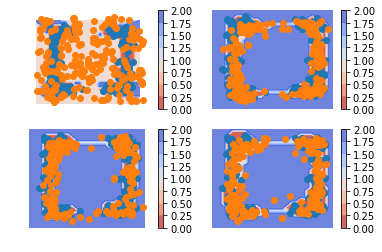

iteration  281
2.3618307 0.012730245 0.86650085 1.4825997


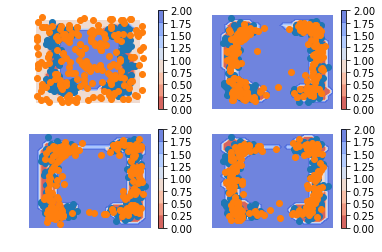

iteration  282
2.0254192 0.013272353 0.817791 1.1943558


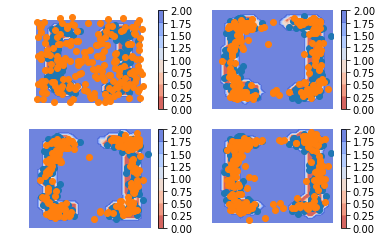

iteration  283
1.9768007 0.01427146 0.833006 1.1295233


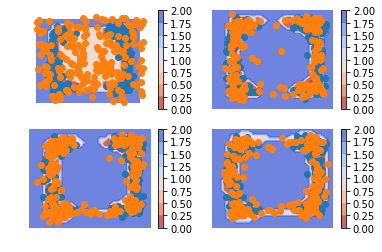

iteration  284
2.4057217 0.014630673 0.82674384 1.5643473


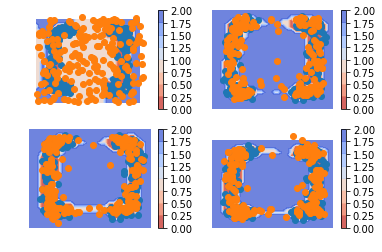

iteration  285
2.0102305 0.015158267 0.8569475 1.1381248


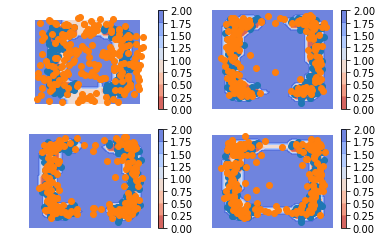

iteration  286
2.2100112 0.015753228 0.8362162 1.3580418


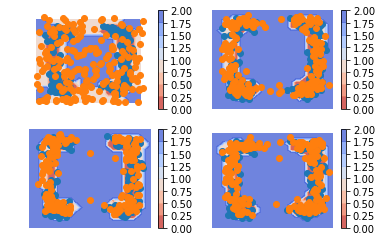

iteration  287
2.3674598 0.016826171 0.8244916 1.5261421


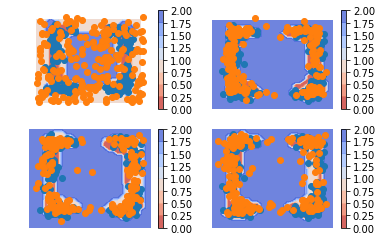

iteration  288
2.239523 0.01784836 0.83119583 1.3904787


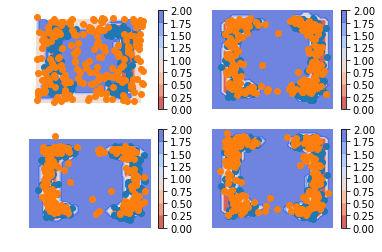

iteration  289
2.420188 0.01968916 0.8460233 1.5544755


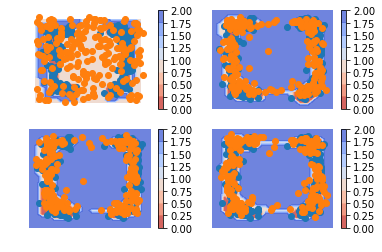

iteration  290
2.2505696 0.020792222 0.82817745 1.4015999


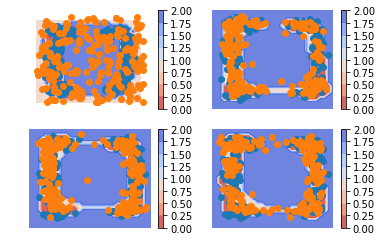

iteration  291
2.0386455 0.021336107 0.8053237 1.2119857


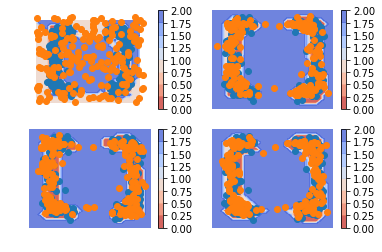

iteration  292
1.8733146 0.022163942 0.813671 1.0374796


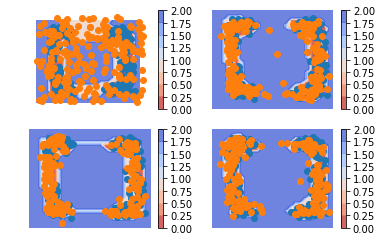

iteration  293
2.4520354 0.022304852 0.83907473 1.5906558


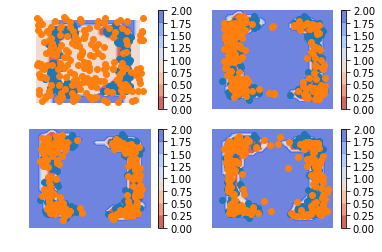

iteration  294
2.0591598 0.02246981 0.8229352 1.2137547


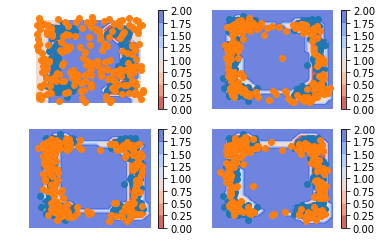

iteration  295
2.2624998 0.021994075 0.84102476 1.3994809


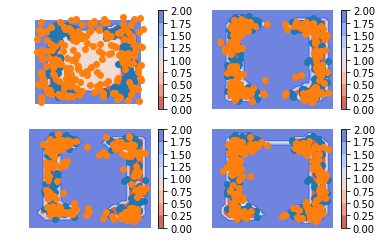

iteration  296
2.1757417 0.02260694 0.82045 1.3326848


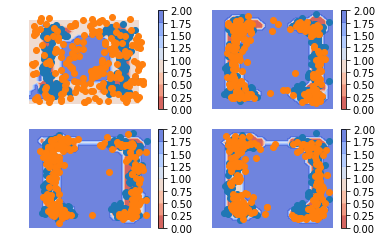

iteration  297
2.4305873 0.022205254 0.82550335 1.5828788


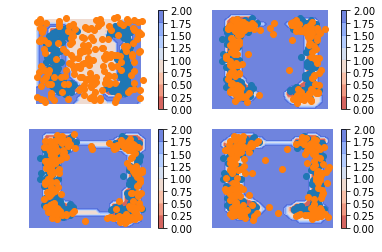

iteration  298
2.3929307 0.022087537 0.82317495 1.5476683


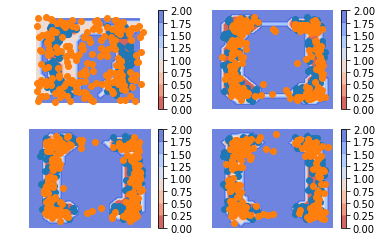

iteration  299
2.4774377 0.021879857 0.7936462 1.6619116


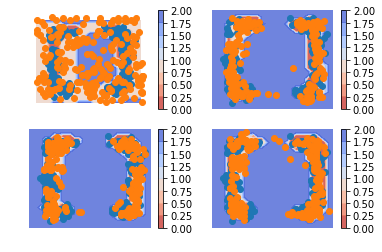

iteration  300
2.10284 0.022373307 0.8244932 1.2559733


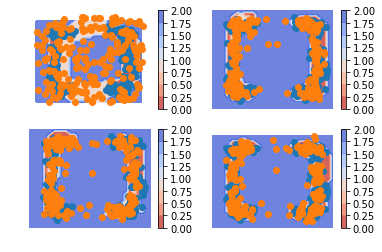

iteration  301
2.5827322 0.023590308 0.89847374 1.6606683


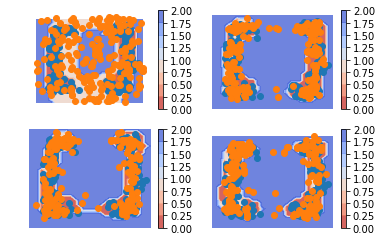

iteration  302
1.9131076 0.024760818 0.81731397 1.0710329


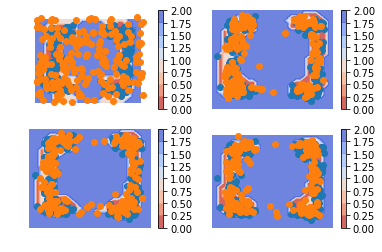

iteration  303
2.0803628 0.02657914 0.82164943 1.2321343


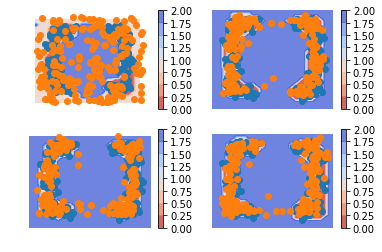

iteration  304
2.0172389 0.026960598 0.82573956 1.1645386


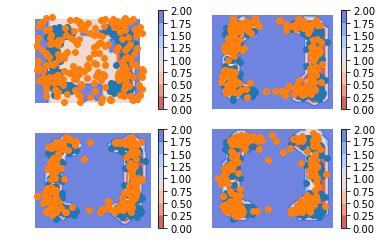

iteration  305
2.6095922 0.027763182 0.7943661 1.787463


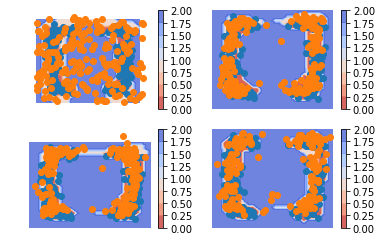

iteration  306
2.3707619 0.028289327 0.7940042 1.5484682


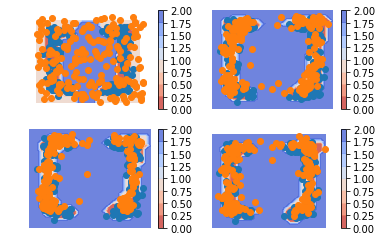

iteration  307
2.4101572 0.028822673 0.88368255 1.4976519


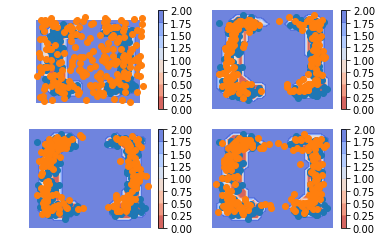

iteration  308
2.012391 0.029593496 0.8376993 1.1450983


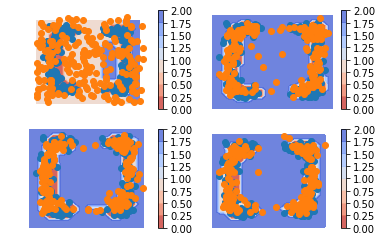

iteration  309
2.200423 0.028949229 0.81436193 1.3571119


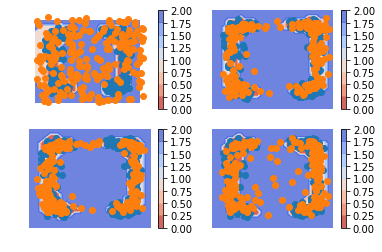

iteration  310
2.3630018 0.028404096 0.804855 1.5297428


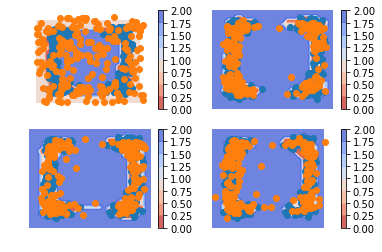

iteration  311
2.273389 0.027555984 0.81126237 1.4345708


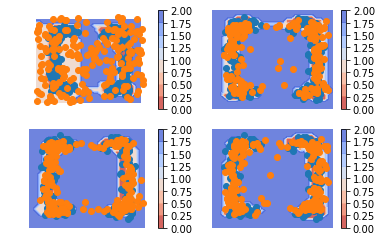

iteration  312
2.084363 0.027484067 0.8052683 1.2516105


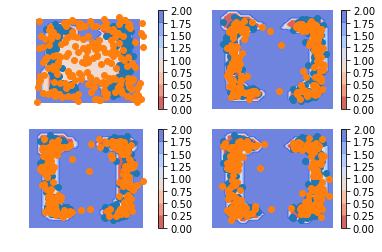

iteration  313
2.3484206 0.027294874 0.854376 1.4667497


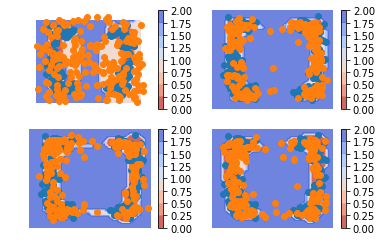

iteration  314
2.524276 0.026897434 0.8446049 1.6527737


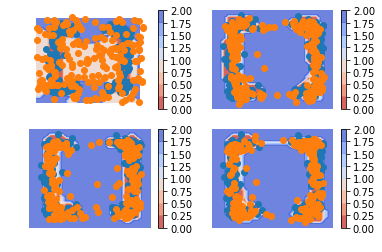

iteration  315
2.1037192 0.0271323 0.83452743 1.2420595


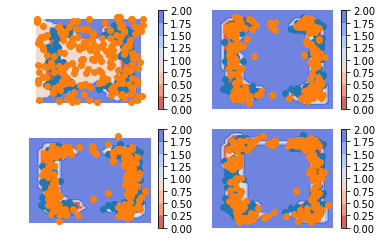

iteration  316
2.3721373 0.02651459 0.82463455 1.5209881


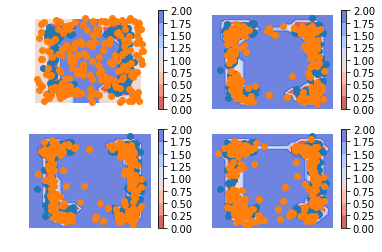

iteration  317
2.3290215 0.026126467 0.8295118 1.4733833


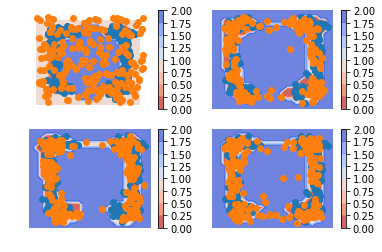

iteration  318
2.3713179 0.027257252 0.8031382 1.5409225


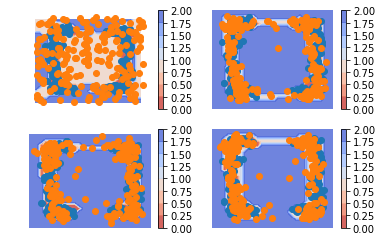

iteration  319
2.3751886 0.027938528 0.8408028 1.5064473


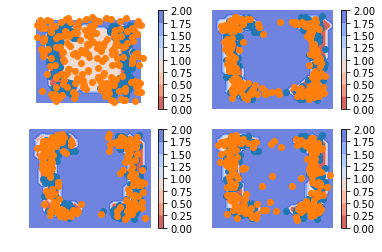

iteration  320
2.1509962 0.027779583 0.80610335 1.3171134


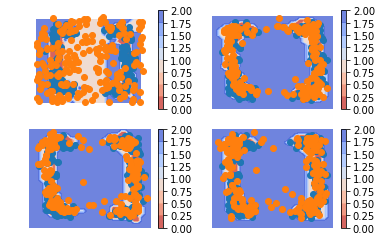

iteration  321
2.11949 0.028458843 0.83071244 1.2603186


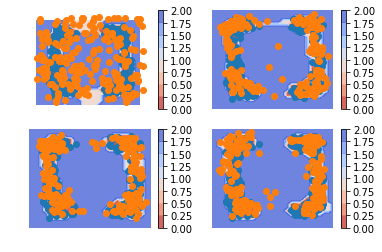

iteration  322
2.3206115 0.028436972 0.8315486 1.460626


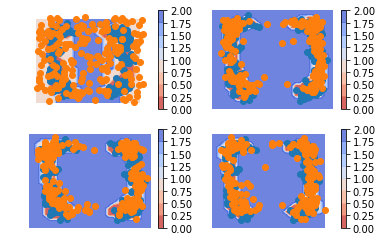

iteration  323
2.1732335 0.028192012 0.81175804 1.3332835


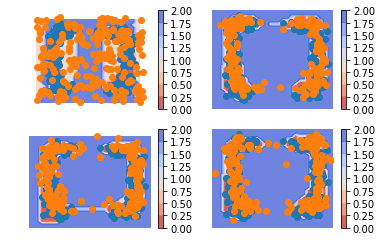

iteration  324
2.3644574 0.028022267 0.82707554 1.5093595


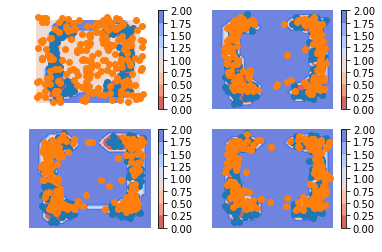

iteration  325
2.0694532 0.028154878 0.8144599 1.2268384


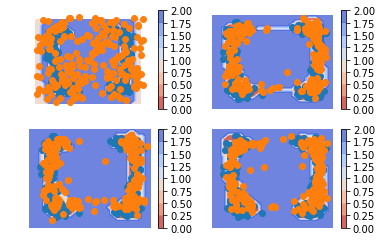

iteration  326
2.5171864 0.027972613 0.809343 1.6798708


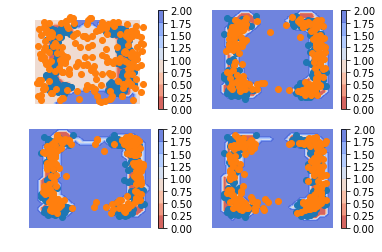

iteration  327
2.555621 0.027638169 0.82358396 1.7043988


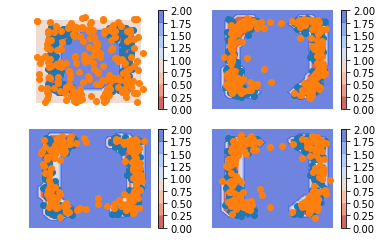

iteration  328
2.5701878 0.027994445 0.8535187 1.6886746


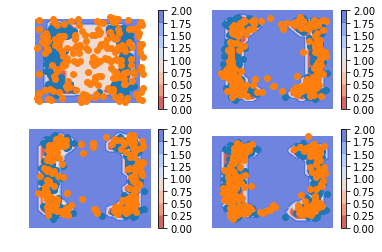

iteration  329
1.8988271 0.02949904 0.8317012 1.0376267


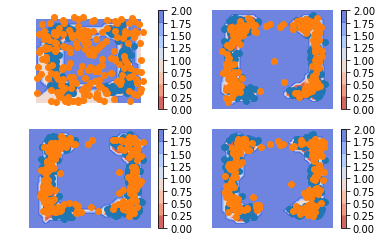

iteration  330
2.2774997 0.027774652 0.8227571 1.4269679


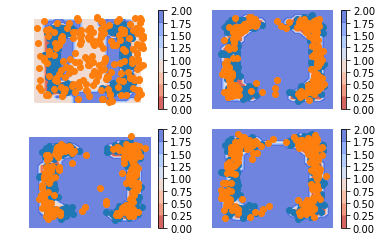

iteration  331
2.1731124 0.028158585 0.8248128 1.3201408


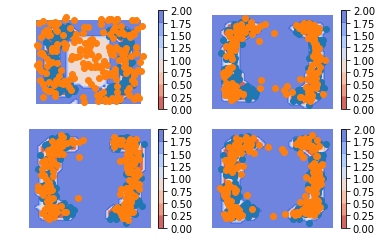

iteration  332
2.3080215 0.026799098 0.8354546 1.4457678


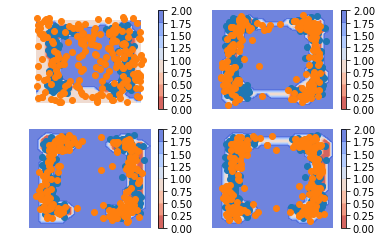

iteration  333
2.49167 0.027733125 0.84470487 1.6192319


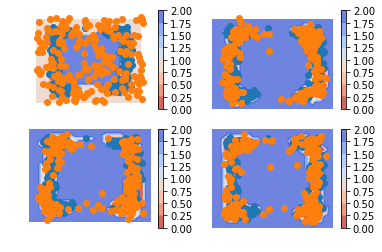

iteration  334
2.5499878 0.027423376 0.82112026 1.7014441


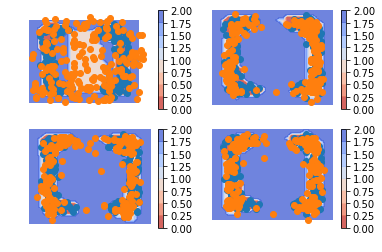

iteration  335
2.37575 0.026814735 0.85436594 1.4945693


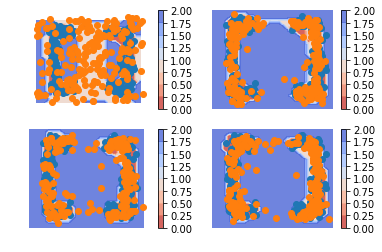

iteration  336
1.8205118 0.026149815 0.8452812 0.9490809


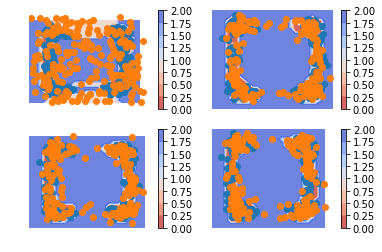

iteration  337
2.1772196 0.02766805 0.84231615 1.3072354


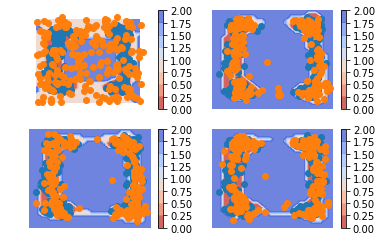

iteration  338
2.1711602 0.026325442 0.8371645 1.3076702


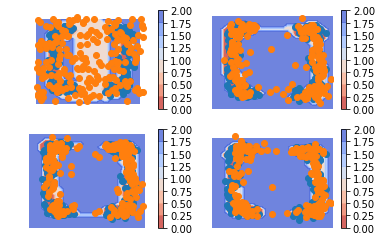

iteration  339
2.5128312 0.025124742 0.8057097 1.6819968


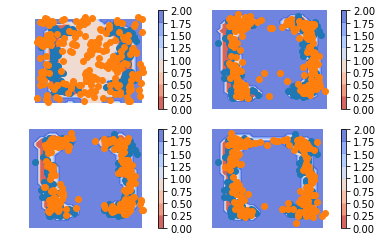

iteration  340
2.4558964 0.024408784 0.82063067 1.6108569


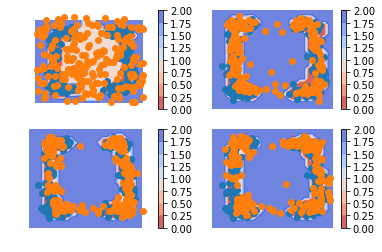

iteration  341
2.2668316 0.023547381 0.81405574 1.4292285


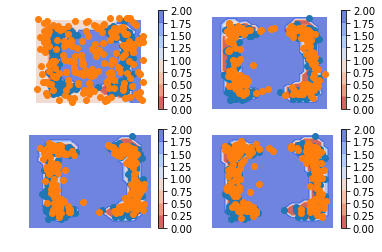

iteration  342
2.2442532 0.023335 0.793012 1.4279062


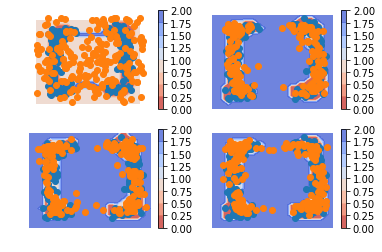

iteration  343
2.3852205 0.02355109 0.8167807 1.5448886


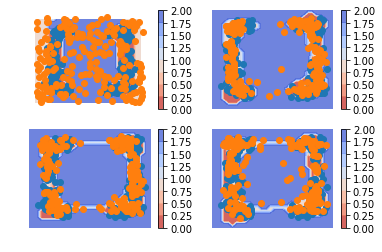

iteration  344
2.389615 0.024812901 0.82290167 1.5419004


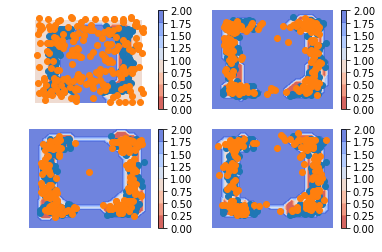

iteration  345
2.4537587 0.025236467 0.836429 1.5920933


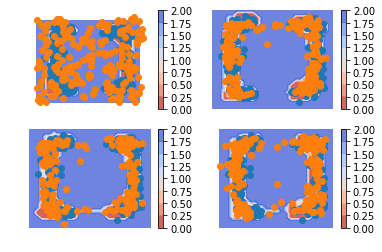

iteration  346
2.3059292 0.024806835 0.8304889 1.4506333


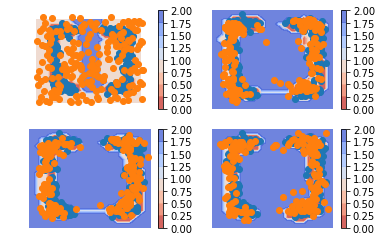

iteration  347
2.2970638 0.024877384 0.7975623 1.4746243


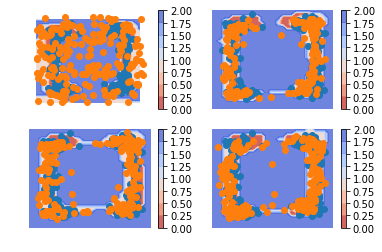

iteration  348
2.3908243 0.024283491 0.84598 1.5205607


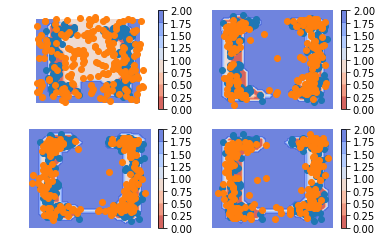

iteration  349
2.1471565 0.024365138 0.8222014 1.3005899


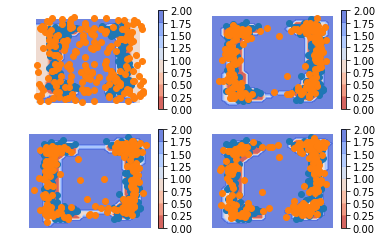

iteration  350
1.9780076 0.024040552 0.85276425 1.1012027


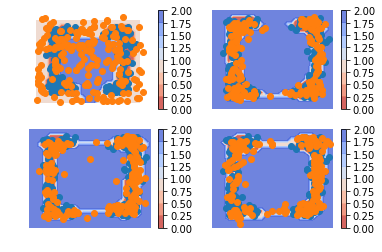

iteration  351
2.4560957 0.023791699 0.857772 1.574532


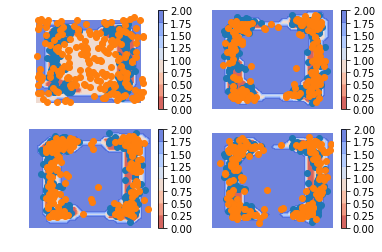

iteration  352
2.0227125 0.024031036 0.813763 1.1849184


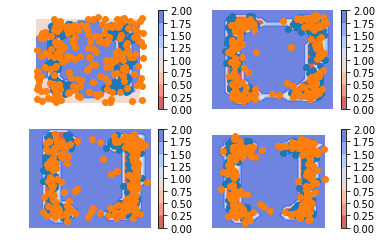

iteration  353
2.6673894 0.023892889 0.8522346 1.791262


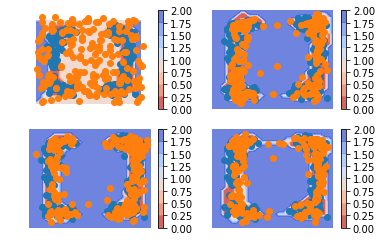

iteration  354
2.1346846 0.024474377 0.8142692 1.2959411


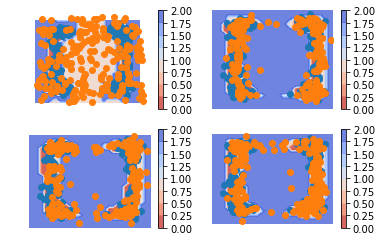

iteration  355
2.184525 0.025664447 0.78254676 1.3763139


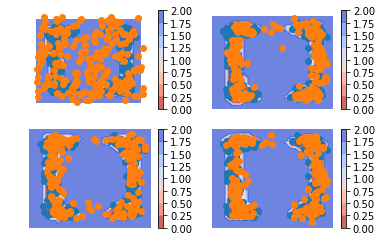

iteration  356
2.1977532 0.026573913 0.8429145 1.3282647


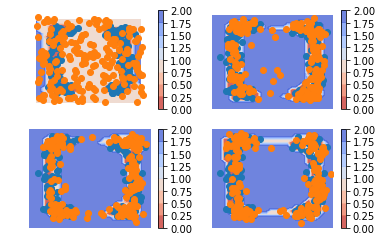

iteration  357
2.3007307 0.026126401 0.8087406 1.4658638


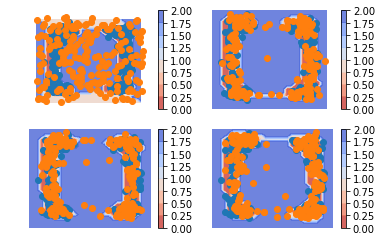

iteration  358
1.9607742 0.027177293 0.8647511 1.0688457


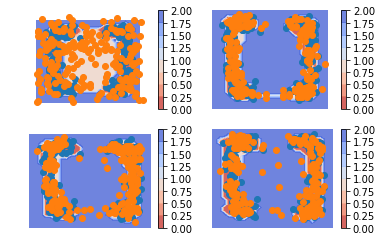

iteration  359
2.1511116 0.027874546 0.82842267 1.2948145


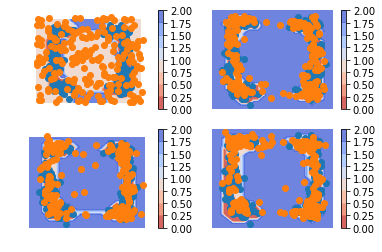

iteration  360
2.0973396 0.0275488 0.8338129 1.2359779


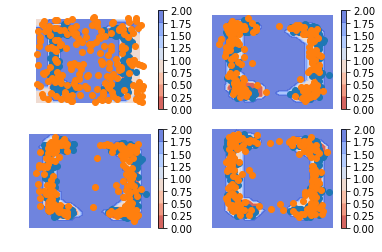

iteration  361
2.4430583 0.027729489 0.8230408 1.592288


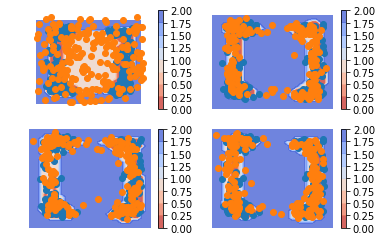

iteration  362
2.0103488 0.027252426 0.82697785 1.1561186


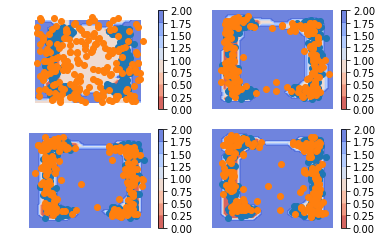

iteration  363
2.6948795 0.027923819 0.8048669 1.8620887


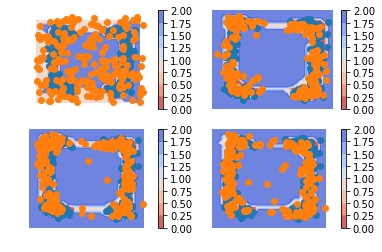

iteration  364
2.3061984 0.027980728 0.8594507 1.4187669


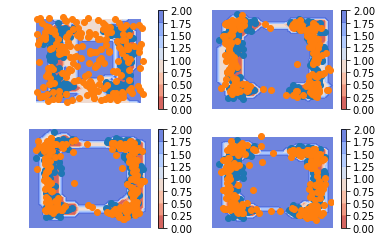

iteration  365
2.1637897 0.027625382 0.8038493 1.3323151


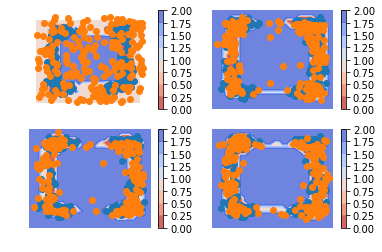

iteration  366
2.4523916 0.02735816 0.82644343 1.5985899


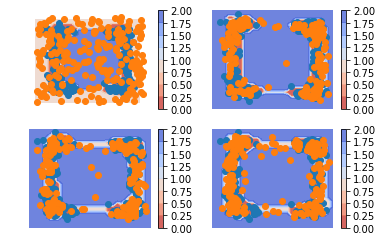

iteration  367
2.1125555 0.026172556 0.84173536 1.2446476


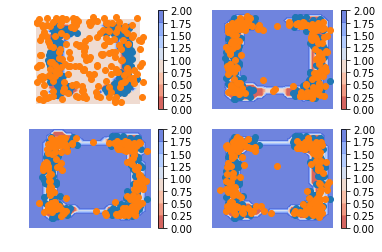

iteration  368
2.093316 0.026049519 0.79826057 1.2690061


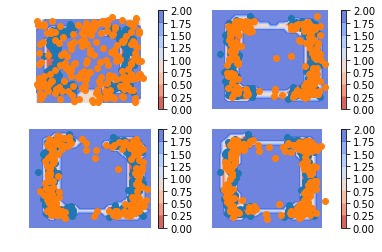

iteration  369
2.383265 0.025424575 0.85269034 1.5051502


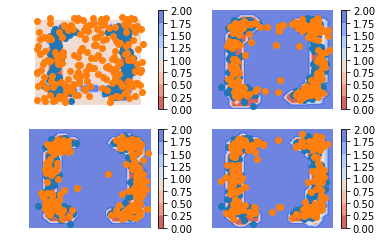

iteration  370
2.4512892 0.024809102 0.86296636 1.5635136


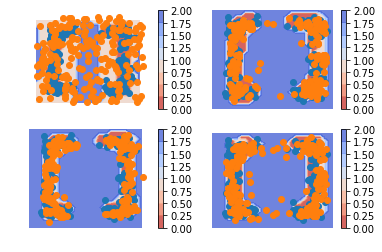

iteration  371
2.0832176 0.023144277 0.87165624 1.188417


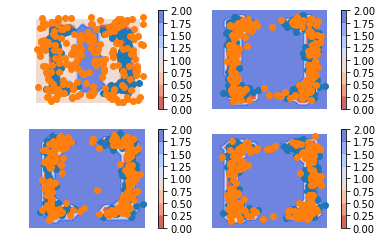

iteration  372
2.1674018 0.022168137 0.8153229 1.3299106


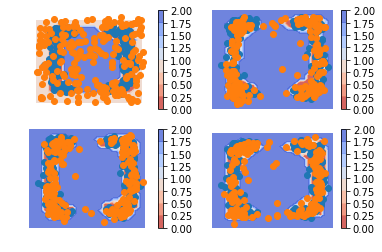

iteration  373
2.0880132 0.02132239 0.8218101 1.2448807


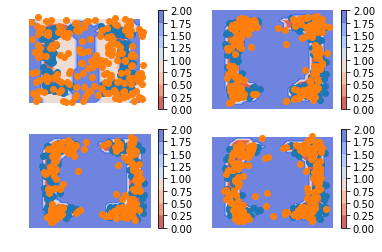

iteration  374
2.1093507 0.01931219 0.8235146 1.266524


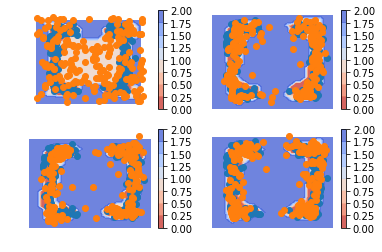

iteration  375
2.030943 0.018680649 0.82671285 1.1855494


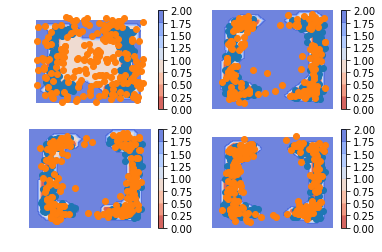

iteration  376
2.0288496 0.016927209 0.8434202 1.1685021


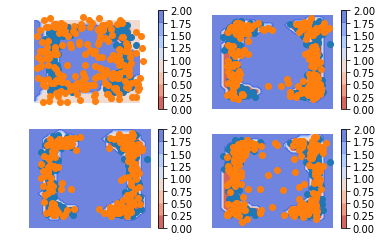

iteration  377
2.1241093 0.016139625 0.84581494 1.2621547


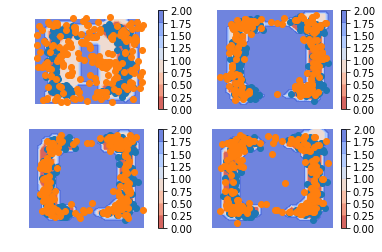

iteration  378
1.9875375 0.015308846 0.84486866 1.12736


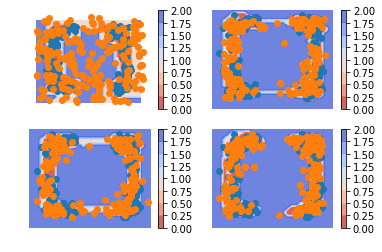

iteration  379
2.3427362 0.01476491 0.8282931 1.4996783


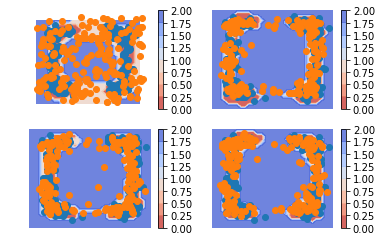

iteration  380
1.9923002 0.0145393675 0.83070695 1.1470538


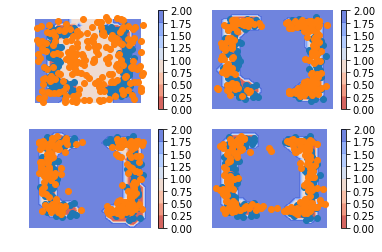

iteration  381
2.2403743 0.014441373 0.8006632 1.4252698


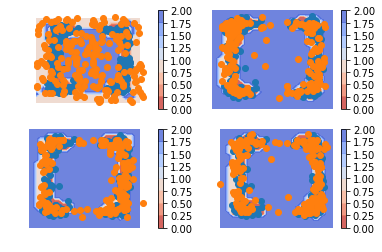

iteration  382
2.075564 0.014670343 0.807897 1.2529966


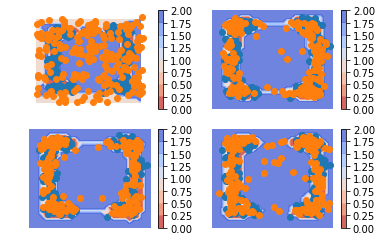

iteration  383
2.0429955 0.014622072 0.8375284 1.1908449


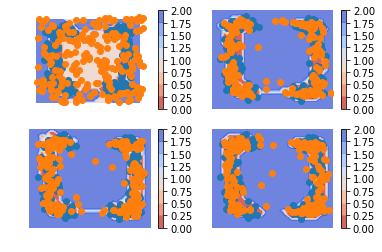

iteration  384
2.010765 0.014673289 0.8300572 1.1660347


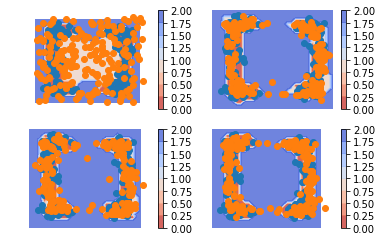

iteration  385
1.8138715 0.014882654 0.7869888 1.0120001


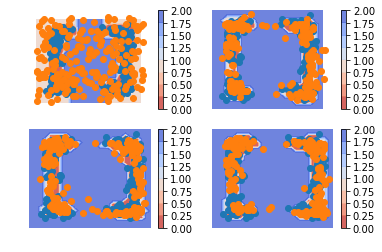

iteration  386
1.9339609 0.01508273 0.81786084 1.1010174


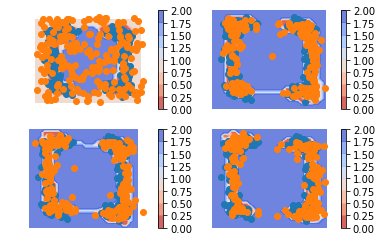

iteration  387
2.0696793 0.014382216 0.8119123 1.2433847


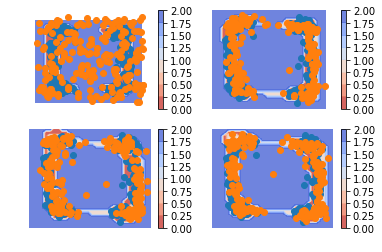

iteration  388
1.9405367 0.013993342 0.8509146 1.0756289


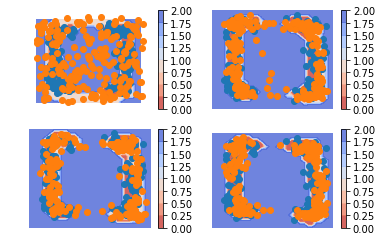

iteration  389
1.7410679 0.014547735 0.80841744 0.9181028


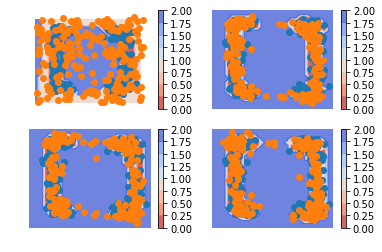

iteration  390
2.0394204 0.014548565 0.84548926 1.1793826


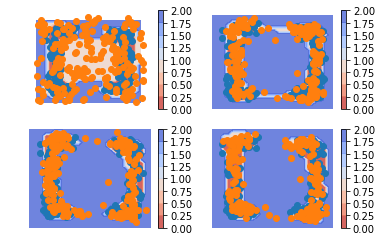

iteration  391
2.5792818 0.014184072 0.85016024 1.7149376


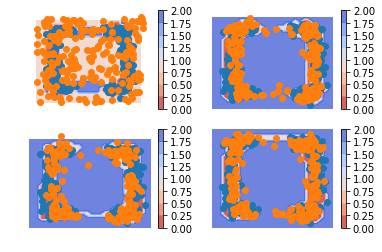

iteration  392
2.1028147 0.014951596 0.7737566 1.3141066


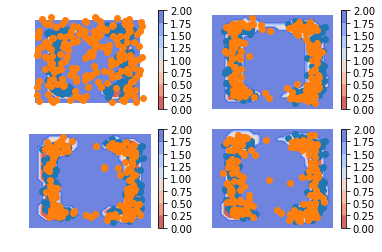

iteration  393
2.3869815 0.014382518 0.7675138 1.605085


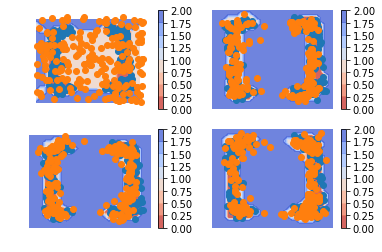

iteration  394
2.7000637 0.015077348 0.82742226 1.8575641


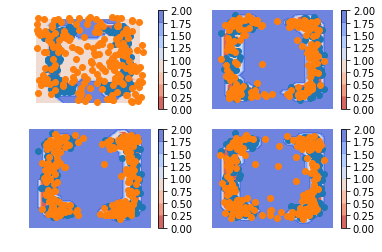

iteration  395
2.4828117 0.014287573 0.79815054 1.6703736


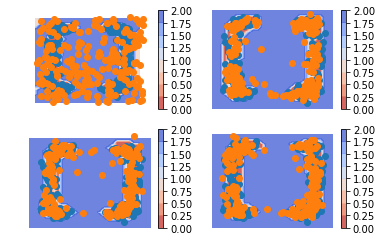

iteration  396
2.366743 0.01449097 0.83090353 1.5213485


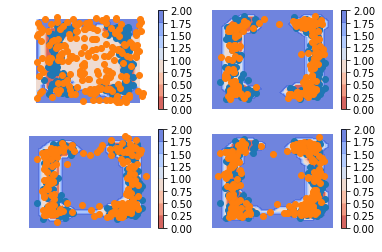

iteration  397
2.2067196 0.0150314905 0.80963755 1.3820506


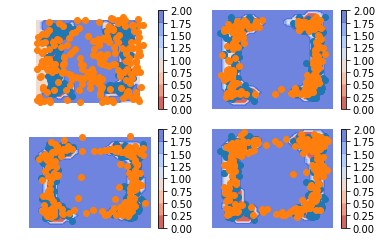

iteration  398
2.4360614 0.01531655 0.7914402 1.6293048


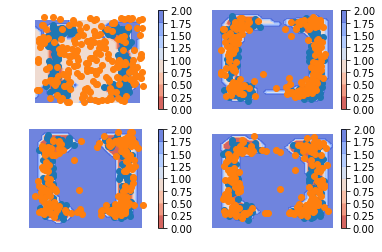

iteration  399
2.3451555 0.016159963 0.8183128 1.5106827


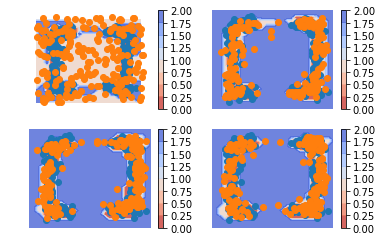

iteration  400
2.2201493 0.017480208 0.852458 1.3502111


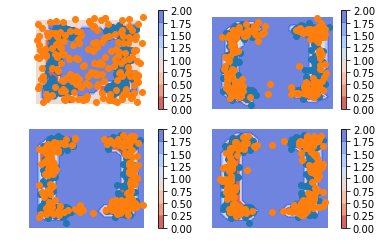

iteration  401
2.2483323 0.018511862 0.8202806 1.4095398


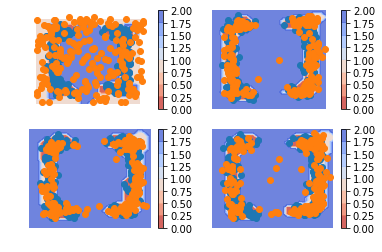

iteration  402
2.1230004 0.019894648 0.84251213 1.2605937


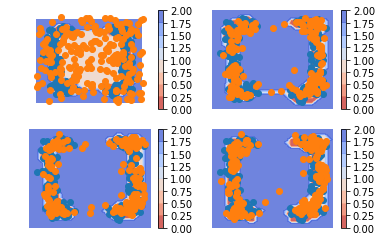

iteration  403
2.5725722 0.022187607 0.8191061 1.7312785


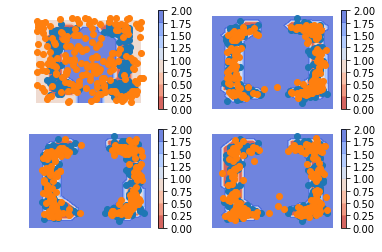

iteration  404
1.9721651 0.023118937 0.84670305 1.1023431


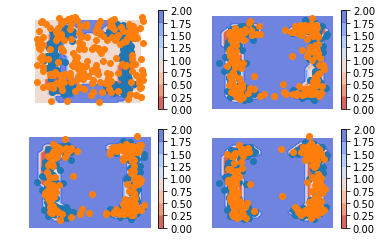

iteration  405
2.1125813 0.024190413 0.8013435 1.2870474


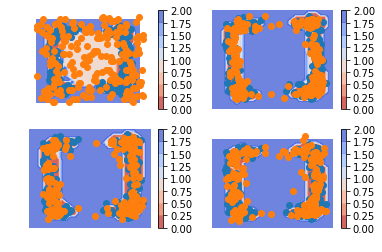

iteration  406
1.7957256 0.024807885 0.822382 0.94853574


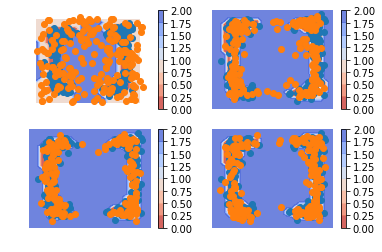

iteration  407
2.1069715 0.025216872 0.82331866 1.258436


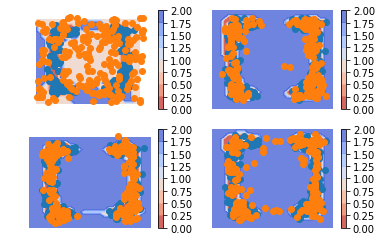

iteration  408
2.0388741 0.02535109 0.8432713 1.1702518


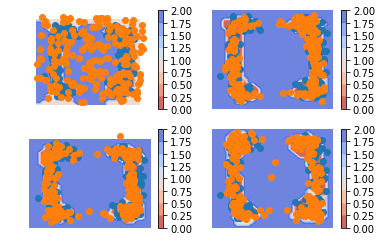

iteration  409
2.2465434 0.026735976 0.8201569 1.3996505


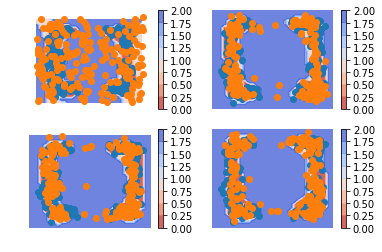

iteration  410
2.0361972 0.026695646 0.82268405 1.1868175


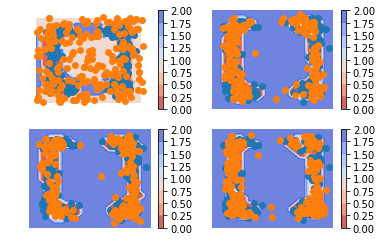

iteration  411
1.9871404 0.026111986 0.8227821 1.1382464


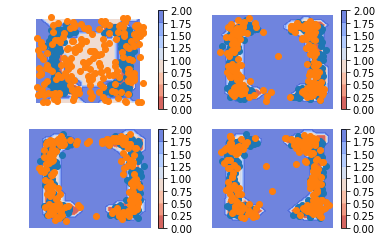

iteration  412
2.2299657 0.02615254 0.8181136 1.3856995


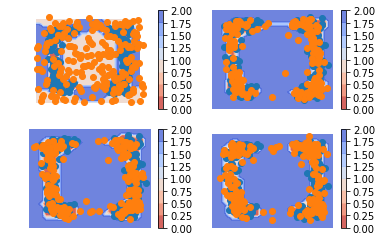

iteration  413
2.363925 0.026341466 0.833733 1.5038505


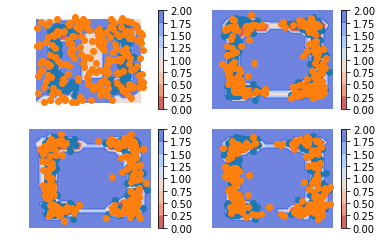

iteration  414
1.975903 0.026107978 0.8394277 1.1103674


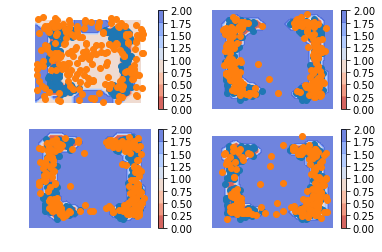

iteration  415
2.0456486 0.02571263 0.8547412 1.1651947


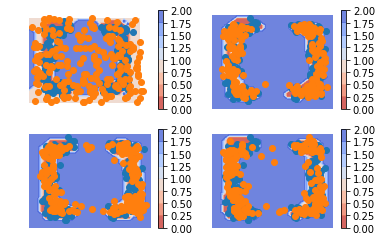

iteration  416
2.0357916 0.024997769 0.8287344 1.1820595


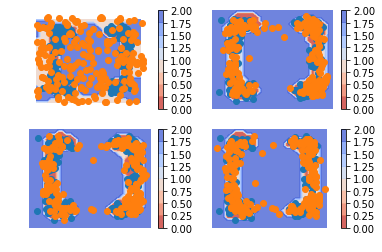

iteration  417
2.1817005 0.024827179 0.84094924 1.315924


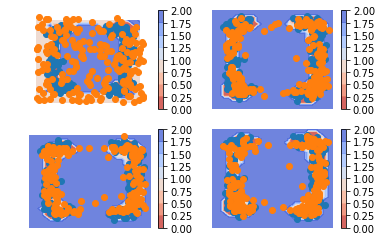

iteration  418
2.4467778 0.02418638 0.8239281 1.5986633


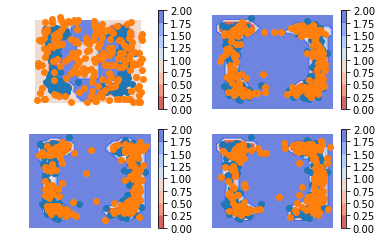

iteration  419
2.3697405 0.023676401 0.821959 1.5241051


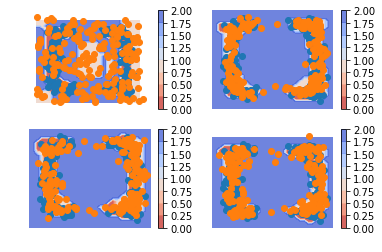

iteration  420
1.9562575 0.023186699 0.81993234 1.1131384


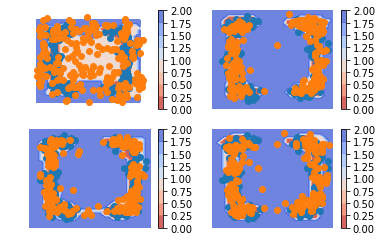

iteration  421
2.131507 0.022543821 0.8137483 1.2952147


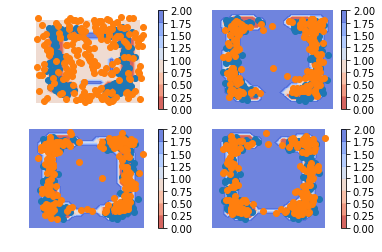

iteration  422
1.97349 0.022392852 0.8493671 1.10173


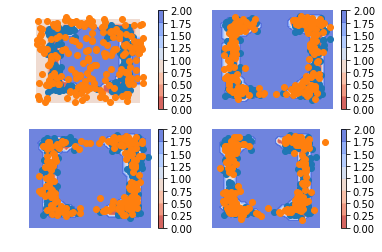

iteration  423
2.1784594 0.022749145 0.84381294 1.3118974


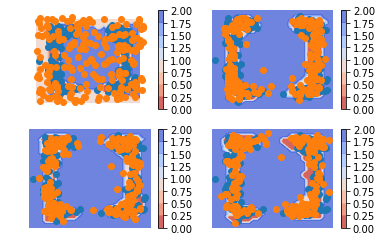

iteration  424
2.1618521 0.022331519 0.82165074 1.3178699


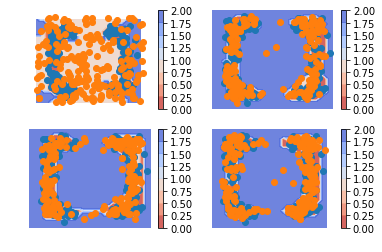

iteration  425
2.0958915 0.022415541 0.85816795 1.215308


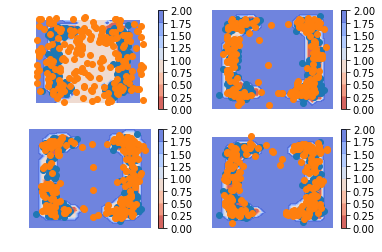

iteration  426
2.268137 0.022439798 0.806285 1.4394121


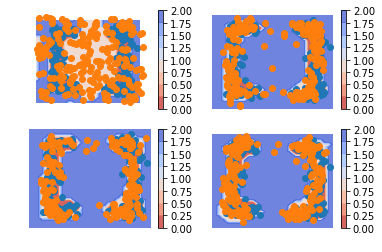

iteration  427
2.0794322 0.02267789 0.8653803 1.1913741


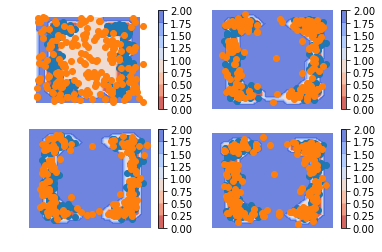

iteration  428
1.9913793 0.023118425 0.83829427 1.1299665


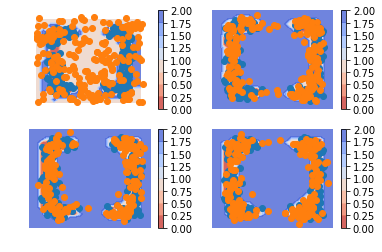

iteration  429
2.2922895 0.02306037 0.83143115 1.4377979


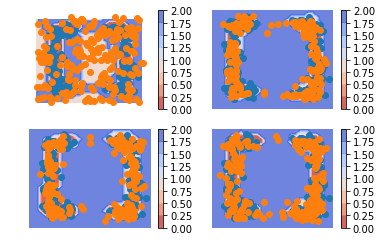

iteration  430
2.0376806 0.02391837 0.83056206 1.1832001


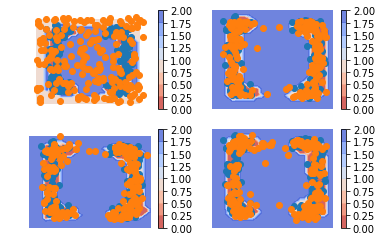

iteration  431
2.2103176 0.023793118 0.85272783 1.3337966


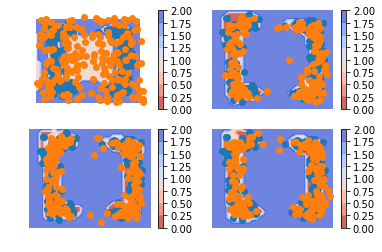

iteration  432
2.0420268 0.024195302 0.8417733 1.1760582


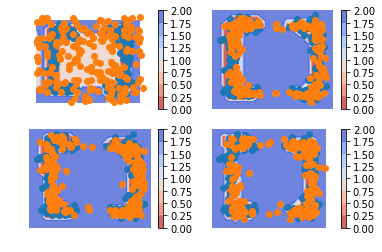

iteration  433
2.10884 0.024133509 0.8291233 1.255583


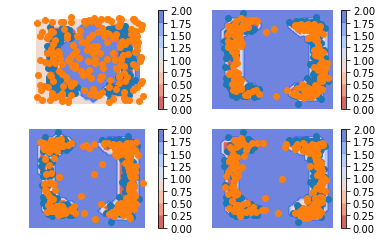

iteration  434
2.2146685 0.024159918 0.80608535 1.3844233


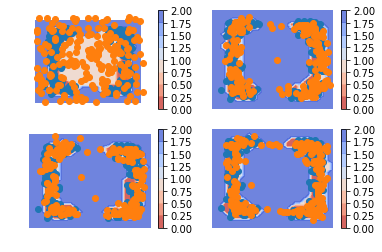

iteration  435
2.0688033 0.025089622 0.82662356 1.2170902


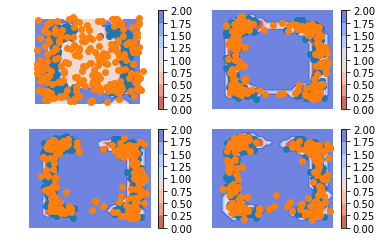

iteration  436
2.1892695 0.025433127 0.8160854 1.3477509


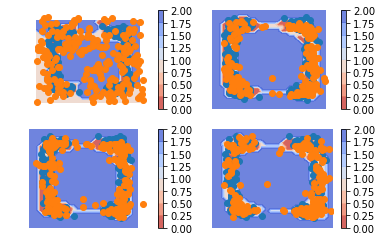

iteration  437
2.184822 0.025744312 0.8189151 1.3401628


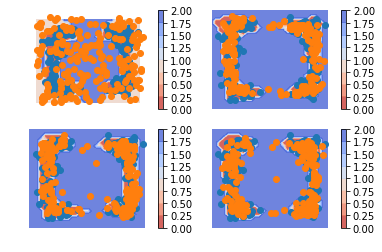

iteration  438
1.7035965 0.025632111 0.8350777 0.8428867


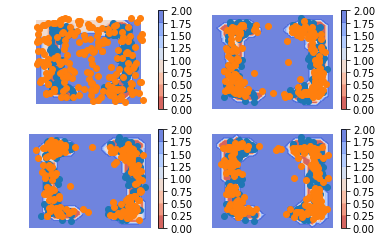

iteration  439
2.0459065 0.02599799 0.8486546 1.171254


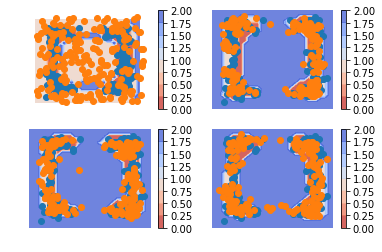

iteration  440
2.381466 0.026453348 0.8460753 1.5089372


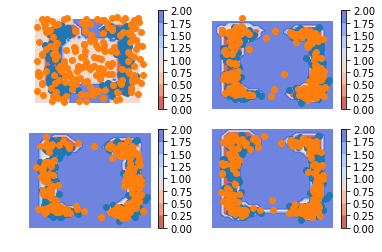

iteration  441
1.9217796 0.026280848 0.84022915 1.0552697


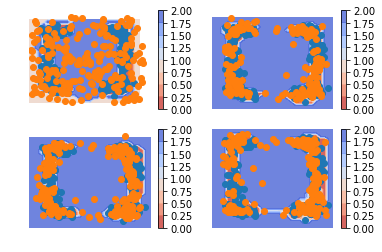

iteration  442
2.2971368 0.027077269 0.8451324 1.4249271


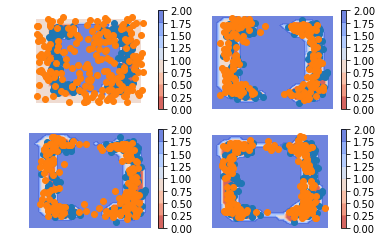

iteration  443
1.8943751 0.026726078 0.7962091 1.0714399


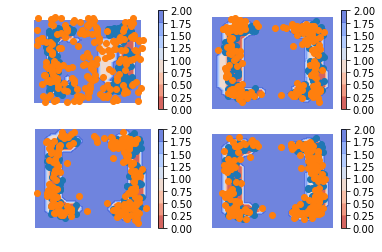

iteration  444
2.3972228 0.027125254 0.81008106 1.5600165


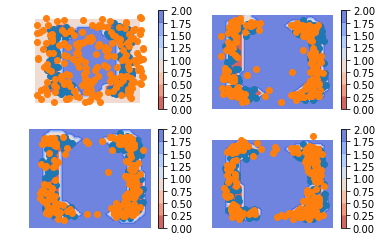

iteration  445
2.5802019 0.028408585 0.78194654 1.7698468


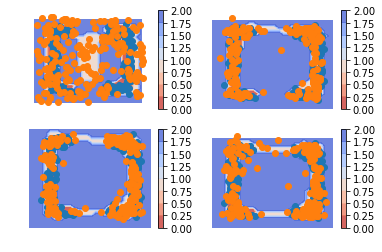

iteration  446
2.820912 0.02801421 0.8272018 1.9656959


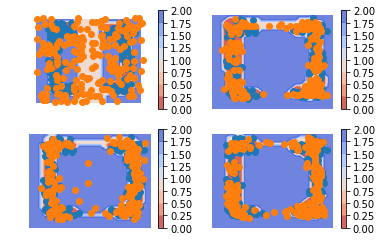

iteration  447
2.0150216 0.02807465 0.8511904 1.1357565


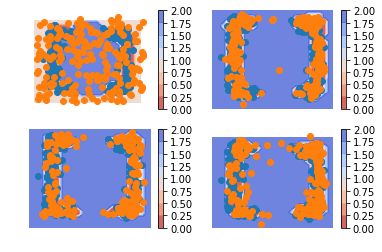

iteration  448
2.1736796 0.028479202 0.8456203 1.2995801


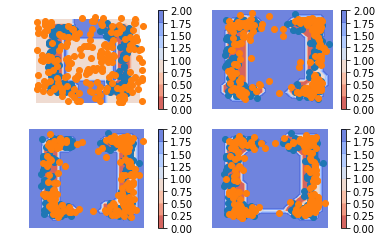

iteration  449
2.1419127 0.027532974 0.8143881 1.2999916


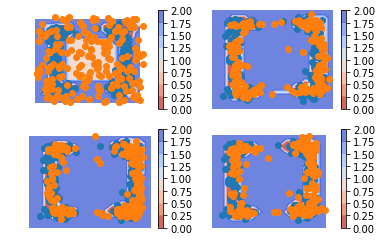

iteration  450
2.254407 0.0288876 0.8077861 1.4177333


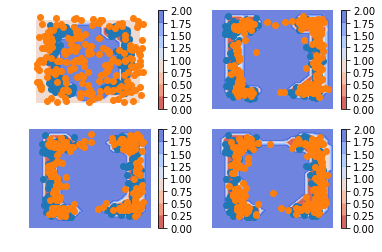

iteration  451
2.593092 0.028443115 0.79272103 1.771928


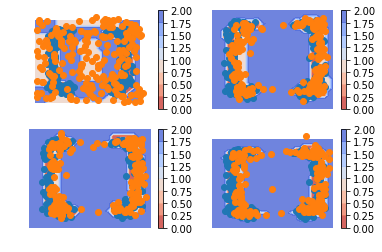

iteration  452
2.8933632 0.03000599 0.7668303 2.0965269


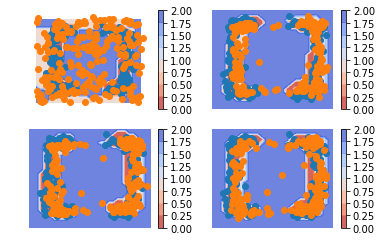

iteration  453
2.335476 0.029884528 0.8029215 1.50267


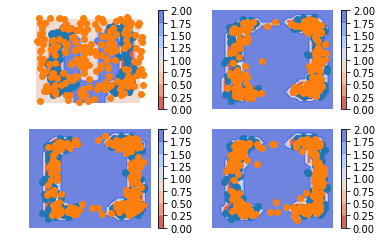

iteration  454
2.4657419 0.029556496 0.77929646 1.6568888


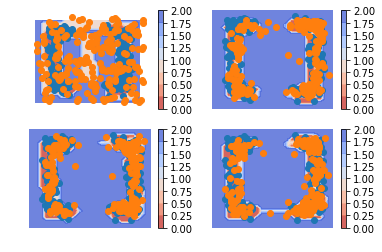

iteration  455
2.4264283 0.031356003 0.8416413 1.553431


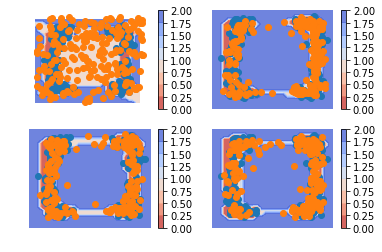

iteration  456
2.6950927 0.030738592 0.83238363 1.8319705


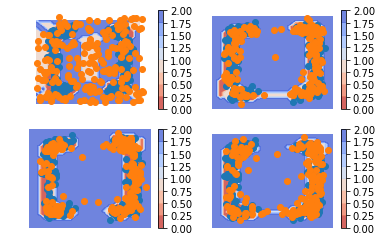

iteration  457
2.380494 0.032693073 0.7969835 1.5508175


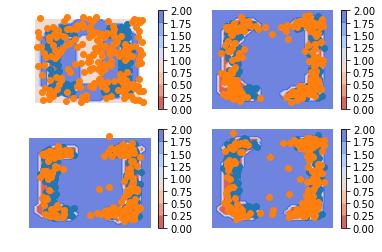

iteration  458
2.7641268 0.035083458 0.8575662 1.871477


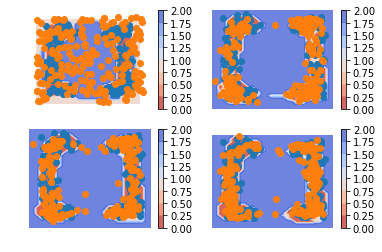

iteration  459
1.928834 0.03415185 0.8353363 1.0593457


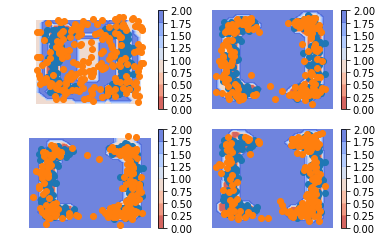

iteration  460
2.3681095 0.037402652 0.83099246 1.4997144


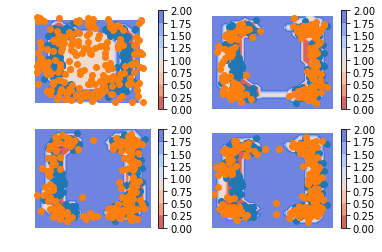

iteration  461
2.2867346 0.03785612 0.7905513 1.4583273


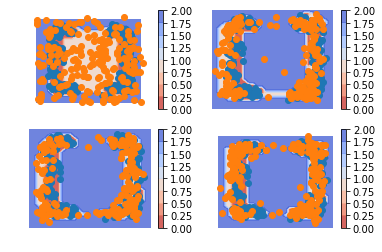

iteration  462
2.3179164 0.037275694 0.7971194 1.4835213


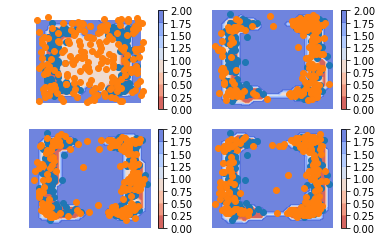

iteration  463
2.3415158 0.04209092 0.83910006 1.4603249


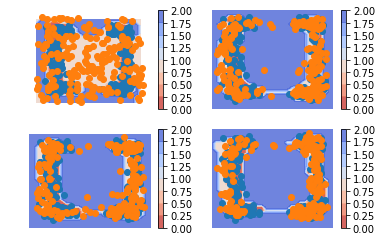

iteration  464
2.095065 0.040470507 0.856225 1.1983696


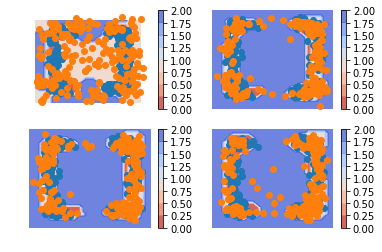

iteration  465
2.352594 0.04331081 0.8038902 1.5053929


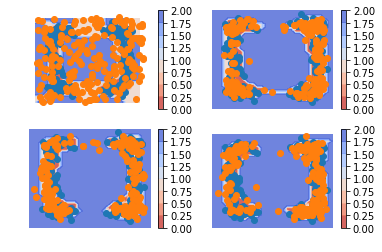

iteration  466
2.6024656 0.042773053 0.8299236 1.7297689


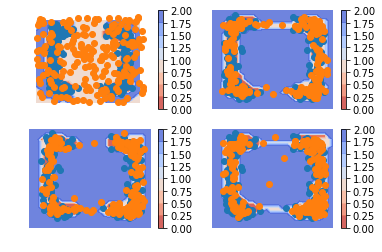

iteration  467
2.4195 0.041824304 0.82165396 1.5560219


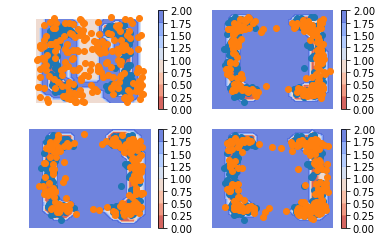

iteration  468
2.405088 0.043127794 0.8649547 1.4970056


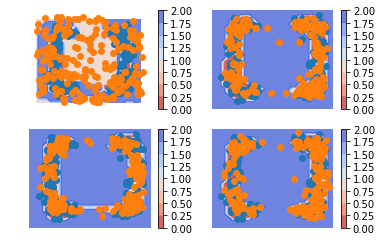

iteration  469
2.1813877 0.041396152 0.79271775 1.3472737


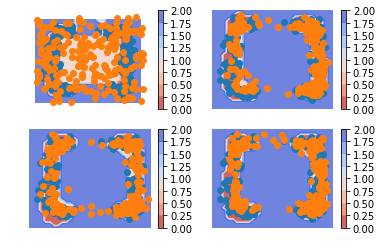

iteration  470
2.446935 0.0398581 0.8542941 1.5527828


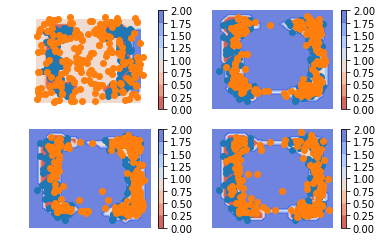

iteration  471
2.20914 0.038888004 0.80820817 1.362044


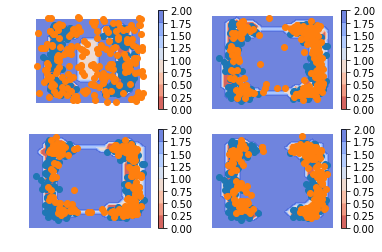

iteration  472
1.8443035 0.040341154 0.8132502 0.99071217


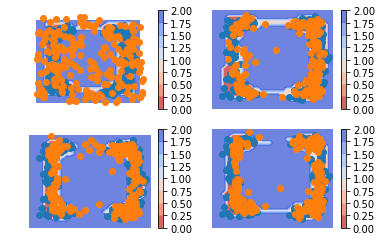

iteration  473
2.2861502 0.040402133 0.82384574 1.4219023


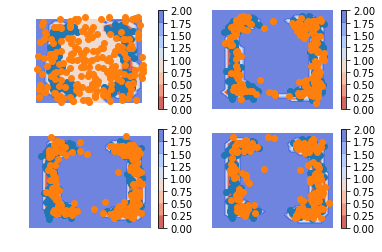

iteration  474
2.1963105 0.04179895 0.8031889 1.3513227


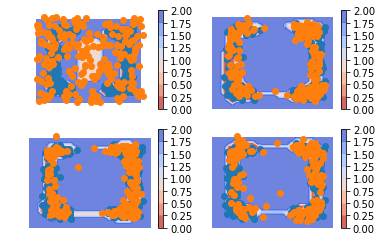

iteration  475
2.260899 0.041352306 0.8339956 1.3855511


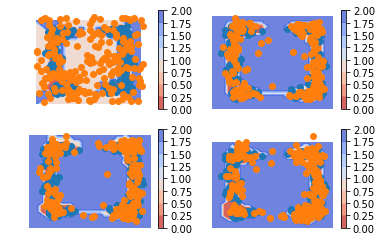

iteration  476
2.527044 0.040899828 0.83277446 1.6533698


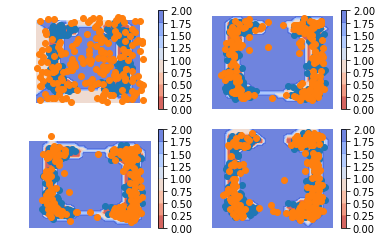

iteration  477
2.0048676 0.042675726 0.8206198 1.141572


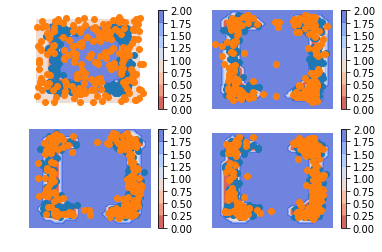

iteration  478
2.1226304 0.043511786 0.8295288 1.2495898


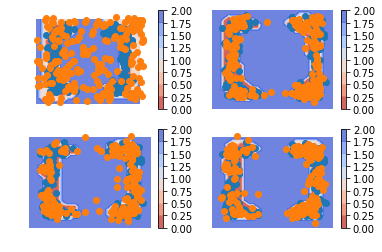

iteration  479
2.1688418 0.04276205 0.81181467 1.314265


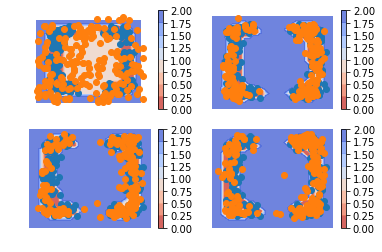

iteration  480
2.2105837 0.043870043 0.8172618 1.3494519


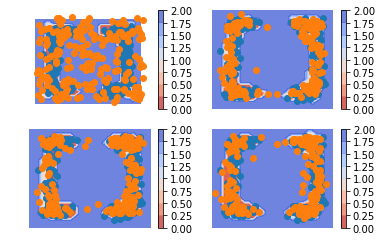

iteration  481
2.1034594 0.044629607 0.87441355 1.184416


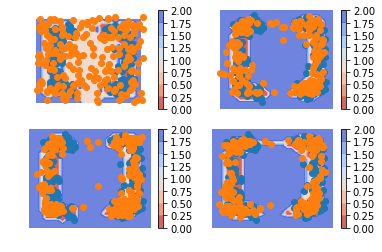

iteration  482
1.9233693 0.041782234 0.8204349 1.0611521


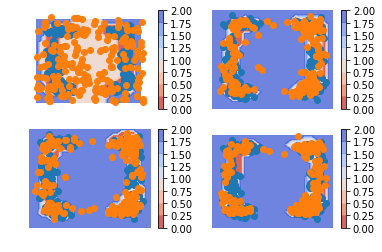

iteration  483
2.028216 0.041730918 0.80460256 1.1818824


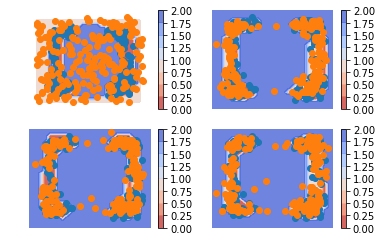

iteration  484
2.7937298 0.041932613 0.80489993 1.9468974


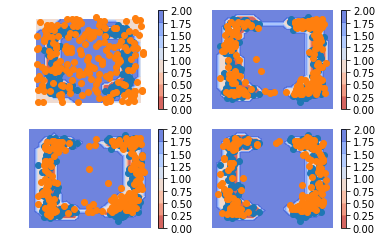

iteration  485
2.4872434 0.040406194 0.8119186 1.6349186


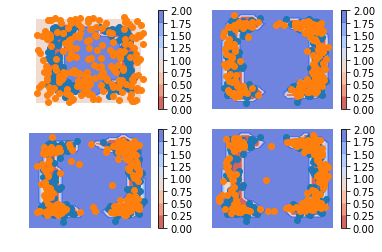

iteration  486
2.2990499 0.040567625 0.81711507 1.441367


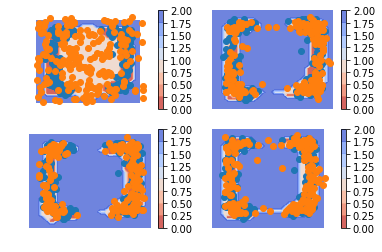

iteration  487
2.1307144 0.03942107 0.82142437 1.269869


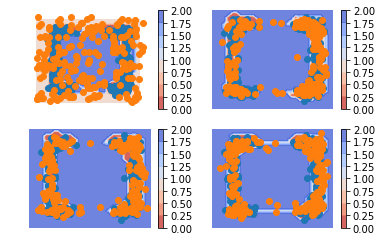

iteration  488
2.3382297 0.039348755 0.8374183 1.4614626


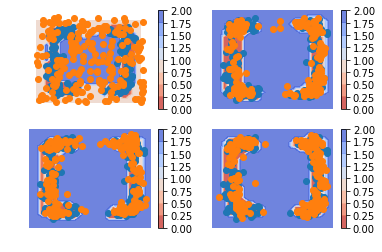

iteration  489
2.0365927 0.038238823 0.78892887 1.209425


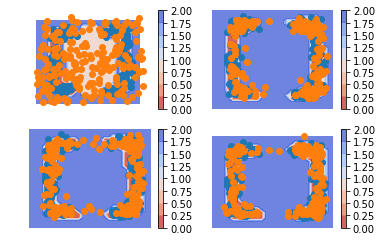

iteration  490
2.2136896 0.037830263 0.817119 1.3587403


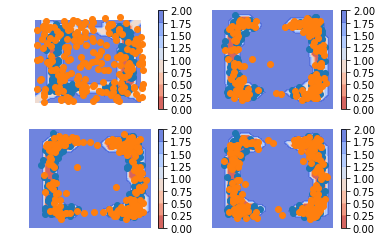

iteration  491
2.6430008 0.037765864 0.84657717 1.7586578


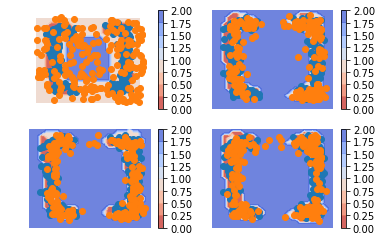

iteration  492
2.5551682 0.03773803 0.784956 1.7324742


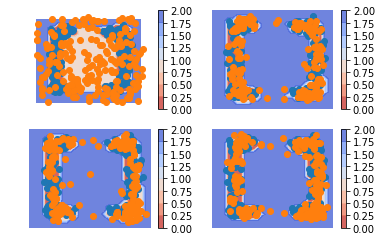

iteration  493
2.4957318 0.03806575 0.8192304 1.6384357


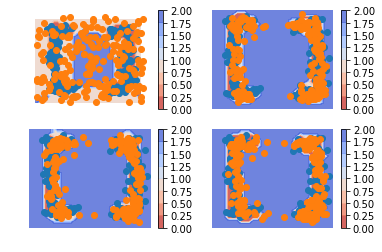

iteration  494
2.883565 0.037916437 0.8469378 1.9987108


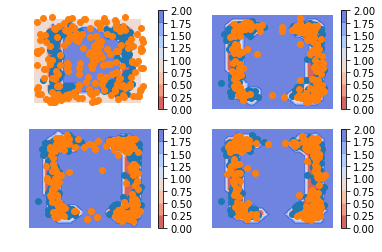

iteration  495
2.0623064 0.038824778 0.80552936 1.2179523


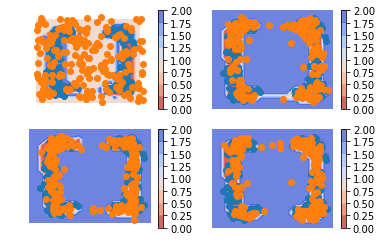

iteration  496
2.1813986 0.03638886 0.81726766 1.3277421


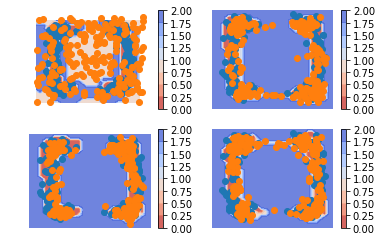

iteration  497
1.9591494 0.03593382 0.7836389 1.1395767


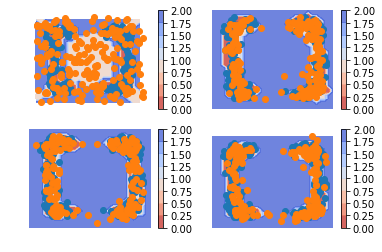

iteration  498
2.08126 0.035163917 0.8220886 1.2240074


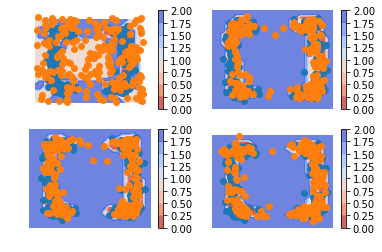

iteration  499
2.1809003 0.03450285 0.83230525 1.3140923


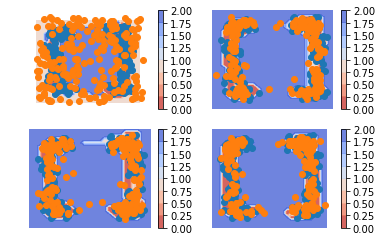

In [11]:
saver=tf.train.Saver()
with tf.Session() as sess:
    tf.global_variables_initializer().run()
    for i in range(500):
        print('iteration ',i)
        X_true=make_toy_dataset_bracket(200,0.1)
        X_fake=np.random.uniform(low=-1.5,high=1.5,size=(200,2))
        X_noise=np.random.uniform(low=-1.5,high=1.5,size=(200,2))
        image=np.vstack((X_true,X_fake,X_noise))
        label=np.concatenate((np.zeros(200),np.ones(200),2*np.ones(200)))
        loss_num,l1,l2,l3,i_his=sess.run([tot_loss,tot_latent_loss,tot_classifier_loss,tot_likelihood_loss,image_his],feed_dict={X:image,y:label})
        for t in range(10):
            _=sess.run([train_step1],feed_dict={X:image,y:label})
        _=sess.run([train_step2],feed_dict={X:image,y:label})
        print(loss_num,l1,l2,l3)
#         print(label)
#         print([(a.reshape(-1,)>0.5).astype(dtype=np.int32) for a in p_his])
        display(i_his,i)
        save_path = saver.save(sess, "parameters/toy/toy.ckpt")

In [12]:
'''
**************************************************************************************************************
There is a problem with classifier. 
Saparate classifier behave well, but in model it fails
**************************************************************************************************************
'''
# t=1
# plt.scatter(i_his[t][:200,0],i_his[t][:200,1])
# plt.scatter(i_his[t][200:,0],i_his[t][200:,1])
# plt.show()

# # n_out1=tf.layers.dense(X,units=100,activation=tf.nn.relu)
# # n_score=tf.layers.dense(n_out1,units=1)

# with tf.variable_scope("temp_scope") as vs:
#     classifier=Classifier()
#     n_score,prob,predict=classifier(X)

# with tf.Session() as sess:
#     tf.global_variables_initializer().run()
    
#     h=0.1
#     xx, yy = np.meshgrid(
#         np.arange(-1.5, 1.5, h),
#         np.arange(-1.5, 1.5, h))
#     points=np.c_[xx.ravel(), yy.ravel()]

#     Z=sess.run(n_score,feed_dict={X:points})
#     Z=Z.reshape(xx.shape)
#     _=plt.contourf(xx,yy,Z,cmap=plt.cm.coolwarm_r, alpha=0.8)
#     plt.scatter(i_his[t][:200,0],i_his[t][:200,1])
#     plt.scatter(i_his[t][200:,0],i_his[t][200:,1])
#     plt.axis('off')
#     plt.colorbar(_)
#     plt.show()
    

'\n**************************************************************************************************************\nThere is a problem with classifier. \nSaparate classifier behave well, but in model it fails\n**************************************************************************************************************\n'

In [13]:
a=tf.constant([[0],[1]])
b=tf.constant([[1],[2]])
d=[a,b]
c=tf.reduce_sum(d,axis=0)

with tf.Session() as sess:
    print(sess.run(d))
    print(sess.run(c))

[array([[0],
       [1]], dtype=int32), array([[1],
       [2]], dtype=int32)]
[[1]
 [3]]


INFO:tensorflow:Restoring parameters from parameters/toy/toy.ckpt


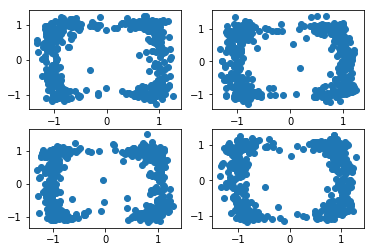

In [14]:
G_batch_size=tf.placeholder(shape=(),dtype=tf.int32,name='batch_size')
G_state_decode=vae.decoder_lstm.zero_state(G_batch_size, tf.float32)
G_unit_gaussian=tf.distributions.Normal(loc=tf.zeros((G_batch_size,vae.latent_dim)),scale=Gaussian_scale*tf.ones((G_batch_size,vae.latent_dim)))

G_output_his=[]

for t in range(vae.n_time):
    G_Z=G_unit_gaussian.sample()
    with tf.variable_scope("LSTM_decoder") as vs:
        G_decode_out,G_state_decode=vae.decoder_lstm(G_Z,G_state_decode)
    G_output_image=vae.emit_net(G_decode_out)
    G_output_his.append(G_output_image)
    
with tf.Session() as sess:
    tf.global_variables_initializer().run()
    saver.restore(sess, "parameters/toy/toy.ckpt")
    output=sess.run(G_output_his,feed_dict={G_batch_size:500})
    plt.figure(1)
    for i in range(4):
        plt.subplot(2,2,i+1)
        plt.scatter(output[i][:,0],output[i][:,1])
    plt.savefig('figures/toy/bracket_dataset/generate_result.png')
    plt.show()

In [15]:
# x=tf.constant([[0,0],[1,1],[2,2],[3,3],[4,4],[5,5],[6,6],[7,7],[8,8],[9,9],[10,10],[11,11],[12,12],[13,13],[14,14],[15,15],[16,16],[17,17],[18,18]])
# a=tf.constant([1,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0])
# N=tf.shape(a)[0]
# b=tf.where(tf.equal(a,0))
# N_0=tf.shape(b)[0]
# b=tf.random_shuffle(b)
# frac=0.9
# tt=tf.cast(tf.cast(N_0,tf.float32)*frac,tf.int32)
# c=b[:tt]
# # d=tf.gather(x,c)
# # f=tf.SparseTensor(indices=[[0],[1],[2]],values=[1,1,1],dense_shape=[10])
# # f=tf.SparseTensor(indices=[[0],[1],[2],[3],[4]],values=ff,dense_shape=[20])
# # sp=tf.constant([N])
# ff=tf.ones(shape=[tt])
# f=tf.SparseTensor(indices=c,values=ff,dense_shape=tf.cast([N],dtype=tf.int64))
# f=tf.sparse_tensor_to_dense(f,validate_indices=False)

# with tf.Session() as sess:
#     print(sess.run([c]))
#     print(sess.run([ff]))
#     print(sess.run([f]))
#     print(sess.run([tt]))

In [16]:
# def resample(image,y,fraction=0.5):
#     '''
#     resample half(or any) partion of pseduo-neg points to random
#     '''
#     tot_num=tf.shape(y)[0]
#     pseduo_index=tf.where(tf.equal(y,1))
#     pseduo_num=tf.shape(pseduo_index)[0]
#     pseduo_index=tf.random_shuffle(pseduo_index)
    
#     frac=tf.cast(tf.cast(pseduo_num,tf.float32)*fraction,tf.int32)
    
#     pseduo_index=pseduo_index[:frac]
#     values=tf.ones(shape=frac)